In [1]:
!pip install transformers

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Colors = ["red", "green", "aqua", 'yellow', 'purple', 'lawngreen', 'orange']

import warnings
warnings.filterwarnings("ignore")

In [3]:
pip install --upgrade numpy

Note: you may need to restart the kernel to use updated packages.


In [4]:
import gensim
from gensim.models.phrases import Phraser, Phrases
from gensim import corpora, models
from gensim import models
from gensim.models import LdaModel, TfidfModel, CoherenceModel
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer,PorterStemmer
from sklearn.feature_extraction.text import CountVectorizer
from gensim.models import Word2Vec, KeyedVectors

On importe nos datasets

In [5]:
data = pd.read_csv("data_saved_data_categories.csv")
train = pd.read_csv ('data_saved_train.csv')
test = pd.read_csv('data_saved_test.csv')

In [6]:
data.head(2)

,Unnamed: 0,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,...,product_specifications,cat_niveau_1,cat_niveau_2,cat_niveau_3,Cluster_cat,cleaned_description,lemmatizer,tokenized,stemmer,tokenize_stem
0,0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,...,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories,Curtains,0,key features of elegance polyester multicolor ...,key feature elegance polyester multicolor abst...,"['key', 'feature', 'elegance', 'polyester', 'm...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol..."
1,1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,...,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin,Baby Bath Towels,1,specifications of sathiyas cotton bath towel 3...,specification sathiyas cotton bath towel bath ...,"['specification', 'sathiyas', 'cotton', 'bath'...",specif sathiya cotton bath towel bath towel re...,"['specif', 'sathiya', 'cotton', 'bath', 'towel..."


In [7]:
print(train.shape)
print(test.shape)

(787, 24)
(263, 24)


Valeurs manquantes:

In [8]:
data.isnull().sum()

Unnamed: 0                   0
uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
cat_niveau_1                 0
cat_niveau_2                 0
cat_niveau_3                 0
Cluster_cat                  0
cleaned_description          0
lemmatizer                   0
tokenized                    0
stemmer                      0
tokenize_stem                0
dtype: int64

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 24 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               1050 non-null   int64  
 1   uniq_id                  1050 non-null   object 
 2   crawl_timestamp          1050 non-null   object 
 3   product_url              1050 non-null   object 
 4   product_name             1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

# Texte

Nous commencons le traitement de notre texte.
Dans le notebook1 on a deja traité le texte de la colone 'description', on a gardé 3 colones : tokenized, stem et lemmatized.
Nous allons voir ici grace a la TSNE et le Score ARI laquelle des actions est la plus interssante pour la classification par la suite.

## 1. Feature Extraction

### **LDA**

In [10]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data['tokenized'],min_count=2, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data['tokenized']], min_count=5, threshold=100)

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram[data['tokenized'][0]])

['[', "'", 'k', 'e', 'y', "'", ',', ' ', "'", 'f', 'e', 'a', 't', 'u', 'r', 'e', "'", ',', ' ', "'", 'e', 'l', 'e', 'g', 'a', 'n', 'c', 'e', "'", ',', ' ', "'", 'p', 'o', 'l', 'y', 'e', 's', 't', 'e', 'r', "'", ',', ' ', "'", 'm', 'u', 'l', 't', 'i', 'c', 'o', 'l', 'o', 'r', "'", ',', ' ', "'", 'a', 'b', 's', 't', 'r', 'a', 'c', 't', "'", ',', ' ', "'", 'e', 'y', 'e', 'l', 'e', 't', "'", ',', ' ', "'", 'd', 'o', 'o', 'r', "'", ',', ' ', "'", 'c', 'u', 'r', 't', 'a', 'i', 'n', "'", ',', ' ', "'", 'f', 'l', 'o', 'r', 'a', 'l', "'", ',', ' ', "'", 'c', 'u', 'r', 't', 'a', 'i', 'n', 'e', 'l', 'e', 'g', 'a', 'n', 'c', 'e', "'", ',', ' ', "'", 'p', 'o', 'l', 'y', 'e', 's', 't', 'e', 'r', "'", ',', ' ', "'", 'm', 'u', 'l', 't', 'i', 'c', 'o', 'l', 'o', 'r', "'", ',', ' ', "'", 'a', 'b', 's', 't', 'r', 'a', 'c', 't', "'", ',', ' ', "'", 'e', 'y', 'e', 'l', 'e', 't', "'", ',', ' ', "'", 'd', 'o', 'o', 'r', "'", ',', ' ', "'", 'c', 'u', 'r', 't', 'a', 'i', 'n', "'", ',', ' ', "'", 'h', 'e', 'i',

In [11]:
len(trigram[data['tokenized'][0]])

1491

In [12]:
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]


In [13]:
# Form Bigrams
data['bigram'] = make_bigrams(data['lemmatizer'])
data['bigram_trigram'] = make_trigrams(data['bigram'])

In [14]:
data['bigram'][0]

['k',
 'e',
 'y',
 ' ',
 'f',
 'e',
 'a',
 't',
 'u',
 'r',
 'e',
 ' ',
 'e',
 'l',
 'e',
 'g',
 'a',
 'n',
 'c',
 'e',
 ' ',
 'p',
 'o',
 'l',
 'y',
 'e',
 's',
 't',
 'e',
 'r',
 ' ',
 'm',
 'u',
 'l',
 't',
 'i',
 'c',
 'o',
 'l',
 'o',
 'r',
 ' ',
 'a',
 'b',
 's',
 't',
 'r',
 'a',
 'c',
 't',
 ' ',
 'e',
 'y',
 'e',
 'l',
 'e',
 't',
 ' ',
 'd',
 'o',
 'o',
 'r',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 ' ',
 'f',
 'l',
 'o',
 'r',
 'a',
 'l',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 'e',
 'l',
 'e',
 'g',
 'a',
 'n',
 'c',
 'e',
 ' ',
 'p',
 'o',
 'l',
 'y',
 'e',
 's',
 't',
 'e',
 'r',
 ' ',
 'm',
 'u',
 'l',
 't',
 'i',
 'c',
 'o',
 'l',
 'o',
 'r',
 ' ',
 'a',
 'b',
 's',
 't',
 'r',
 'a',
 'c',
 't',
 ' ',
 'e',
 'y',
 'e',
 'l',
 'e',
 't',
 ' ',
 'd',
 'o',
 'o',
 'r',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 ' ',
 'h',
 'e',
 'i',
 'g',
 'h',
 't',
 ' ',
 'p',
 'a',
 'c',
 'k',
 ' ',
 'p',
 'r',
 'i',
 'c',
 'e',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a'

In [15]:
def word_count(sent):

    """
    Fonction pour calculer le nombre de mots
    """
    word2cnt = dict()
    for word in sent.split():
        if word in word2cnt: word2cnt[word] += 1
        else: word2cnt[word] = 1
    return word2cnt

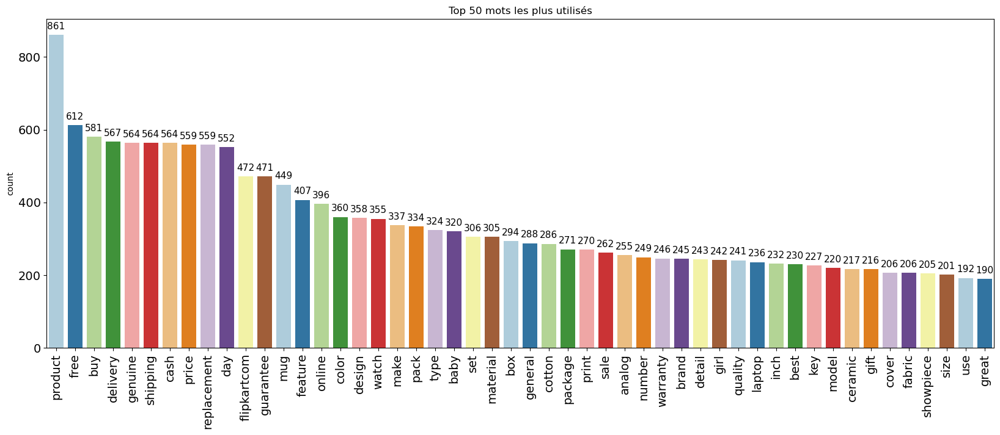

In [16]:
data_1_cat = data.copy()
data_1_cat ['bigram'] = 1
df = data_1_cat .groupby(['bigram'])['lemmatizer'].transform(lambda x : ' '.join(x))[0]
text_total = word_count(df)
word_items = text_total.items()
df_word_repeat = pd.DataFrame(word_items,columns = ['word','count']).sort_values(by='count', ascending = False)
df_word_repeat

fig, ax = plt.subplots(figsize=(20,7))
sns.barplot(x='word', y='count', data=df_word_repeat.head(50), ax=ax, palette='Paired')

plt.title('Top 50 mots les plus utilisés')
plt.xticks(rotation='vertical')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('', fontsize=14)

# Ajouter les annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points',
                fontsize = 11,
                #  rotation='vertical',
                )

Nous remarquons ici que le mots le plus utilisé est "product"

In [17]:
data['bigram_trigram'][0]

['k',
 'e',
 'y',
 ' ',
 'f',
 'e',
 'a',
 't',
 'u',
 'r',
 'e',
 ' ',
 'e',
 'l',
 'e',
 'g',
 'a',
 'n',
 'c',
 'e',
 ' ',
 'p',
 'o',
 'l',
 'y',
 'e',
 's',
 't',
 'e',
 'r',
 ' ',
 'm',
 'u',
 'l',
 't',
 'i',
 'c',
 'o',
 'l',
 'o',
 'r',
 ' ',
 'a',
 'b',
 's',
 't',
 'r',
 'a',
 'c',
 't',
 ' ',
 'e',
 'y',
 'e',
 'l',
 'e',
 't',
 ' ',
 'd',
 'o',
 'o',
 'r',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 ' ',
 'f',
 'l',
 'o',
 'r',
 'a',
 'l',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 'e',
 'l',
 'e',
 'g',
 'a',
 'n',
 'c',
 'e',
 ' ',
 'p',
 'o',
 'l',
 'y',
 'e',
 's',
 't',
 'e',
 'r',
 ' ',
 'm',
 'u',
 'l',
 't',
 'i',
 'c',
 'o',
 'l',
 'o',
 'r',
 ' ',
 'a',
 'b',
 's',
 't',
 'r',
 'a',
 'c',
 't',
 ' ',
 'e',
 'y',
 'e',
 'l',
 'e',
 't',
 ' ',
 'd',
 'o',
 'o',
 'r',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a',
 'i',
 'n',
 ' ',
 'h',
 'e',
 'i',
 'g',
 'h',
 't',
 ' ',
 'p',
 'a',
 'c',
 'k',
 ' ',
 'p',
 'r',
 'i',
 'c',
 'e',
 ' ',
 'c',
 'u',
 'r',
 't',
 'a'

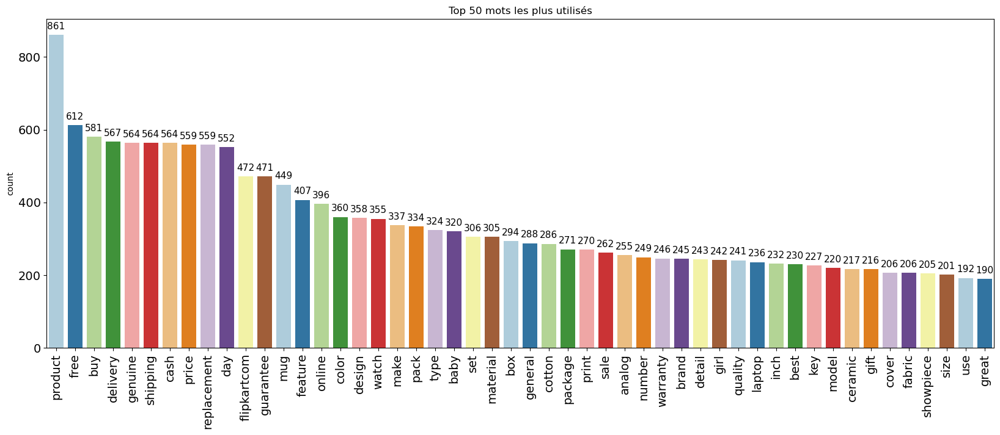

In [18]:
data_1 = data.copy()
data_1['bigram_trigram'] = 1
df = data_1.groupby(['bigram_trigram'])['lemmatizer'].transform(lambda x : ' '.join(x))[0]
text_total = word_count(df)
word_items = text_total.items()
df_word_repeat = pd.DataFrame(word_items,columns = ['word','count']).sort_values(by='count', ascending = False)
df_word_repeat

fig, ax = plt.subplots(figsize=(20,7))
sns.barplot(x='word', y='count', data=df_word_repeat.head(50), ax=ax, palette='Paired')

plt.title('Top 50 mots les plus utilisés')
plt.xticks(rotation='vertical')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('', fontsize=14)

# Ajouter les annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points',
                fontsize = 11,
                #  rotation='vertical',
                )

In [31]:
 # Créez un objet de corpora.Dictionary()
id2word = corpora.Dictionary(data['bigram_trigram'])

text = data['bigram_trigram']

# l'id du mot et sa fréquence dans chaque document
corpus = [id2word.doc2bow(text) for text in text]

print(corpus[0])

[(0, 143), (1, 75), (2, 13), (3, 45), (4, 20), (5, 115), (6, 8), (7, 32), (8, 25), (9, 64), (10, 1), (11, 11), (12, 57), (13, 28), (14, 62), (15, 67), (16, 22), (17, 1), (18, 73), (19, 42), (20, 89), (21, 27), (22, 6), (23, 8), (24, 1), (25, 23)]


In [32]:
len(id2word)

27

If we look at the name of this algorithm, we can see that the word 'Latent' indicates that the model finds hidden topics in documents, and the word 'Dirichlet' indicates that LDA assumes that the distribution of topics in a document and the distribution of words in topics are both Dirichlet distributions.

In [33]:
#construction du modele LDA

lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=7,
                                           random_state=9,
                                           update_every=2,
                                           chunksize=49,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True
                                            )

In [34]:
# Print the Keyword in the 7 topics
print(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0, '0.150*" " + 0.081*"e" + 0.069*"i" + 0.069*"a" + 0.065*"l" + 0.060*"n" + 0.057*"t" + 0.045*"o" + 0.045*"h" + 0.041*"g"'), (1, '0.145*" " + 0.107*"e" + 0.073*"r" + 0.065*"t" + 0.064*"a" + 0.062*"o" + 0.060*"l" + 0.056*"n" + 0.052*"i" + 0.048*"s"'), (2, '0.140*" " + 0.112*"a" + 0.071*"e" + 0.069*"i" + 0.065*"r" + 0.054*"o" + 0.051*"n" + 0.048*"l" + 0.047*"t" + 0.045*"c"'), (3, '0.161*" " + 0.089*"e" + 0.085*"a" + 0.071*"r" + 0.059*"t" + 0.057*"c" + 0.054*"s" + 0.049*"i" + 0.045*"o" + 0.043*"l"'), (4, '0.155*" " + 0.131*"e" + 0.065*"t" + 0.060*"a" + 0.057*"i" + 0.048*"r" + 0.046*"o" + 0.044*"l" + 0.039*"f" + 0.038*"c"'), (5, '0.125*" " + 0.114*"e" + 0.086*"i" + 0.066*"r" + 0.060*"a" + 0.058*"c" + 0.055*"t" + 0.055*"o" + 0.046*"l" + 0.045*"n"'), (6, '0.135*" " + 0.111*"e" + 0.096*"a" + 0.076*"t" + 0.062*"r" + 0.061*"n" + 0.054*"o" + 0.051*"c" + 0.051*"s" + 0.048*"i"')]


In [35]:
# identifier le numéro de topic pour chaque document
def get_max(doc):
        idx,l = zip(*doc)
        return idx[np.argmax(l)]

# Affecter les clusters
cluster=[]
for i in range(len(corpus)):
  x_topic = lda_model.get_document_topics( corpus[i] , minimum_probability = 0.0001 , minimum_phi_value = None , per_word_topics = False )
  cluster.append(get_max(x_topic))

In [36]:
data['Cluster'] = cluster

In [37]:
data.shape

(1050, 17)

In [38]:
data.columns

Index(['Unnamed: 0', 'uniq_id', 'product_url', 'product_name',
       'discounted_price', 'image', 'description', 'cat_niveau_1',
       'Cluster_cat', 'cleaned_description', 'lemmatizer', 'tokenized',
       'stemmer', 'tokenize_stem', 'bigram', 'bigram_trigram', 'Cluster'],
      dtype='object')

In [39]:
data.drop(['crawl_timestamp','is_FK_Advantage_product','brand','pid','cat_niveau_2',
       'cat_niveau_3', 'product_rating', 'overall_rating', 'retail_price',
                           'product_specifications'], axis = 1 , inplace = True)

KeyError: "['crawl_timestamp', 'is_FK_Advantage_product', 'brand', 'pid', 'cat_niveau_2', 'cat_niveau_3', 'product_rating', 'overall_rating', 'retail_price', 'product_specifications'] not found in axis"

In [40]:
data.shape

(1050, 17)

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Unnamed: 0           1050 non-null   int64  
 1   uniq_id              1050 non-null   object 
 2   product_url          1050 non-null   object 
 3   product_name         1050 non-null   object 
 4   discounted_price     1049 non-null   float64
 5   image                1050 non-null   object 
 6   description          1050 non-null   object 
 7   cat_niveau_1         1050 non-null   object 
 8   Cluster_cat          1050 non-null   int64  
 9   cleaned_description  1050 non-null   object 
 10  lemmatizer           1050 non-null   object 
 11  tokenized            1050 non-null   object 
 12  stemmer              1050 non-null   object 
 13  tokenize_stem        1050 non-null   object 
 14  bigram               1050 non-null   object 
 15  bigram_trigram       1050 non-null   o

In [42]:
%time
data['lemmatizer'].apply(word_count)

CPU times: total: 0 ns
Wall time: 0 ns


0       {'key': 1, 'feature': 2, 'elegance': 3, 'polye...
1       {'specification': 1, 'sathiyas': 3, 'cotton': ...
2       {'key': 1, 'feature': 2, 'eurospa': 6, 'cotton...
3       {'key': 1, 'feature': 1, 'santosh': 3, 'royal'...
4       {'key': 1, 'feature': 1, 'jaipur': 5, 'print':...
                              ...                        
1045    {'oren': 1, 'empower': 1, 'extra': 1, 'large':...
1046    {'wallmantra': 5, 'large': 1, 'vinyl': 3, 'sti...
1047    {'buy': 1, 'uberlyfe': 2, 'extra': 2, 'large':...
1048    {'buy': 1, 'wallmantra': 2, 'medium': 2, 'viny...
1049    {'buy': 1, 'uberlyfe': 2, 'large': 2, 'vinyl':...
Name: lemmatizer, Length: 1050, dtype: object

### TF-IDF

In [43]:
data.head()

,Unnamed: 0,uniq_id,product_url,product_name,discounted_price,image,description,cat_niveau_1,Cluster_cat,cleaned_description,lemmatizer,tokenized,stemmer,tokenize_stem,bigram,bigram_trigram,Cluster
0,0,55b85ea15a1536d46b7190ad6fff8ce7,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,0,key features of elegance polyester multicolor ...,key feature elegance polyester multicolor abst...,"['key', 'feature', 'elegance', 'polyester', 'm...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol...","[k, e, y, , f, e, a, t, u, r, e, , e, l, e, ...","[k, e, y, , f, e, a, t, u, r, e, , e, l, e, ...",1
1,1,7b72c92c2f6c40268628ec5f14c6d590,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,1,specifications of sathiyas cotton bath towel 3...,specification sathiyas cotton bath towel bath ...,"['specification', 'sathiyas', 'cotton', 'bath'...",specif sathiya cotton bath towel bath towel re...,"['specif', 'sathiya', 'cotton', 'bath', 'towel...","[s, p, e, c, i, f, i, c, a, t, i, o, n, , s, ...","[s, p, e, c, i, f, i, c, a, t, i, o, n, , s, ...",1
2,2,64d5d4a258243731dc7bbb1eef49ad74,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,1,key features of eurospa cotton terry face towe...,key feature eurospa cotton terry face towel se...,"['key', 'feature', 'eurospa', 'cotton', 'terry...",key featur eurospa cotton terri face towel set...,"['key', 'featur', 'eurospa', 'cotton', 'terri'...","[k, e, y, , f, e, a, t, u, r, e, , e, u, r, ...","[k, e, y, , f, e, a, t, u, r, e, , e, u, r, ...",1
3,3,d4684dcdc759dd9cdf41504698d737d8,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,0,key features of santosh royal fashion cotton p...,key feature santosh royal fashion cotton print...,"['key', 'feature', 'santosh', 'royal', 'fashio...",key featur santosh royal fashion cotton print ...,"['key', 'featur', 'santosh', 'royal', 'fashion...","[k, e, y, , f, e, a, t, u, r, e, , s, a, n, ...","[k, e, y, , f, e, a, t, u, r, e, , s, a, n, ...",1
4,4,6325b6870c54cd47be6ebfbffa620ec7,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,0,key features of jaipur print cotton floral kin...,key feature jaipur print cotton floral king si...,"['key', 'feature', 'jaipur', 'print', 'cotton'...",key featur jaipur print cotton floral king siz...,"['key', 'featur', 'jaipur', 'print', 'cotton',...","[k, e, y, , f, e, a, t, u, r, e, , j, a, i, ...","[k, e, y, , f, e, a, t, u, r, e, , j, a, i, ...",1


In [44]:
data.shape

(1050, 17)

In [45]:
tfidf = TfidfVectorizer()
# tfidf = TfidfVectorizer()
matrix_cat = tfidf.fit_transform(data['lemmatizer'])

print(matrix_cat)

  (0, 2574)	0.02824693862847348
  (0, 461)	0.039620427547949054
  (0, 3005)	0.05487304589717072
  (0, 3667)	0.05477571330327551
  (0, 914)	0.03169487943798882
  (0, 2882)	0.027534525780052437
  (0, 496)	0.025979666997875545
  (0, 2389)	0.03946890396196218
  (0, 1180)	0.03155052273164266
  (0, 821)	0.026959558289581142
  (0, 1293)	0.07759948643905555
  (0, 3765)	0.030723097642746933
  (0, 2790)	0.03581034244051335
  (0, 2689)	0.06310104546328532
  (0, 4432)	0.026547772386418967
  (0, 507)	0.02768323677157762
  (0, 1766)	0.02462263618120195
  (0, 4142)	0.07759948643905555
  (0, 136)	0.07019512626519891
  (0, 3568)	0.05607582148317345
  (0, 1777)	0.04321470261436998
  (0, 2411)	0.0412671011354602
  (0, 1585)	0.07326821339551623
  (0, 3950)	0.07759948643905555
  (0, 531)	0.05198460873783717
  :	:
  (1048, 1884)	0.06550716825184916
  (1048, 3512)	0.06407003577752629
  (1048, 1066)	0.0623323539347236
  (1048, 1772)	0.05889453932775958
  (1048, 2932)	0.07236486109959499
  (1048, 581)	0.058130

In [46]:
# def get_top_keywords(data, clusters, labels, n_terms):
#     df = data_cat.groupby(clusters).mean()

#     for i,r in df.iterrows():
#         print('\nCluster {}'.format(i))
#         print(','.join([labels[t] for t in np.argsort(r)[-n_terms:]]))

# get_top_keywords(x, 'Cluster_cat', tfidf.get_feature_names(), 10)

In [47]:
%time
data['lemmatizer'].apply(word_count)

CPU times: total: 0 ns
Wall time: 0 ns


0       {'key': 1, 'feature': 2, 'elegance': 3, 'polye...
1       {'specification': 1, 'sathiyas': 3, 'cotton': ...
2       {'key': 1, 'feature': 2, 'eurospa': 6, 'cotton...
3       {'key': 1, 'feature': 1, 'santosh': 3, 'royal'...
4       {'key': 1, 'feature': 1, 'jaipur': 5, 'print':...
                              ...                        
1045    {'oren': 1, 'empower': 1, 'extra': 1, 'large':...
1046    {'wallmantra': 5, 'large': 1, 'vinyl': 3, 'sti...
1047    {'buy': 1, 'uberlyfe': 2, 'extra': 2, 'large':...
1048    {'buy': 1, 'wallmantra': 2, 'medium': 2, 'viny...
1049    {'buy': 1, 'uberlyfe': 2, 'large': 2, 'vinyl':...
Name: lemmatizer, Length: 1050, dtype: object

In [48]:
len(tfidf.vocabulary_)

4776

TfidfVectorizer nous permet de voir que nous avons un vocabulaire de 4776 quand il s'agit de Lemmatize

In [49]:
tfidf.vocabulary_

{'key': 2276,
 'feature': 1554,
 'elegance': 1357,
 'polyester': 3207,
 'multicolor': 2753,
 'abstract': 18,
 'eyelet': 1500,
 'door': 1236,
 'curtain': 1025,
 'floral': 1637,
 'curtainelegance': 1026,
 'height': 1963,
 'pack': 3004,
 'price': 3279,
 'enhances': 1391,
 'look': 2462,
 'interiorsthis': 2168,
 'make': 2532,
 'high': 1978,
 'quality': 3375,
 'fabricit': 1508,
 'style': 4110,
 'stitch': 4067,
 'metal': 2636,
 'ringit': 3571,
 'room': 3602,
 'environment': 1412,
 'romantic': 3598,
 'lovingthis': 2484,
 'ant': 164,
 'wrinkle': 4727,
 'anti': 168,
 'shrinkage': 3838,
 'elegant': 1358,
 'apparancegive': 190,
 'home': 2005,
 'bright': 522,
 'modernistic': 2692,
 'appeal': 192,
 'design': 1130,
 'surreal': 4173,
 'attention': 263,
 'sure': 4164,
 'steal': 4048,
 'heart': 1955,
 'contemporary': 912,
 'valance': 4491,
 'slide': 3903,
 'smoothly': 3925,
 'draw': 1247,
 'apart': 185,
 'first': 1601,
 'thing': 4292,
 'morning': 2715,
 'welcome': 4643,
 'sun': 4136,
 'ray': 3430,
 'wan

In [50]:
import wordcloud

In [51]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

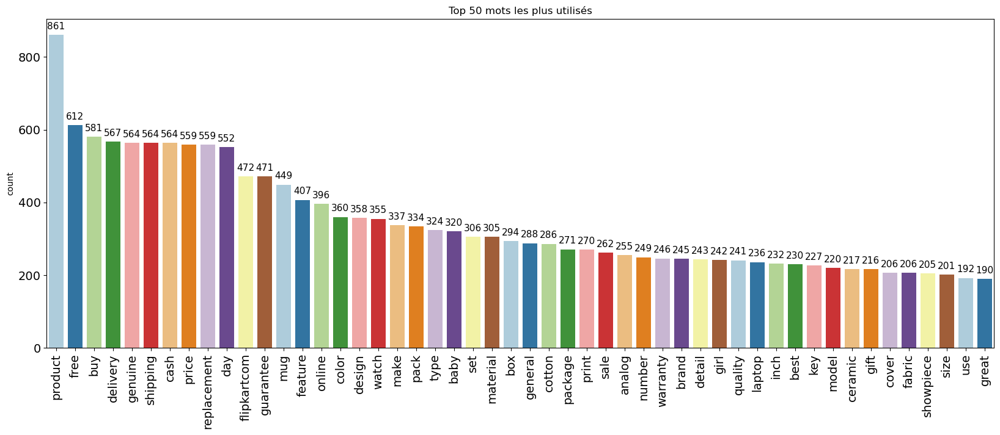

In [52]:
data['group'] = 1
df = data.groupby(['group'])['lemmatizer'].transform(lambda x : ' '.join(x))[0]
text_total = word_count(df)
word_items = text_total.items()
df_word_repeat = pd.DataFrame(word_items,columns = ['word','count']).sort_values(by='count', ascending = False)
df_word_repeat

fig, ax = plt.subplots(figsize=(20,7))
sns.barplot(x='word', y='count', data=df_word_repeat.head(50), ax=ax, palette='Paired')

plt.title('Top 50 mots les plus utilisés')
plt.xticks(rotation='vertical')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('', fontsize=14)

# Ajouter les annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points',
                fontsize = 11,
                #  rotation='vertical',
                )

In [53]:
from wordcloud import WordCloud

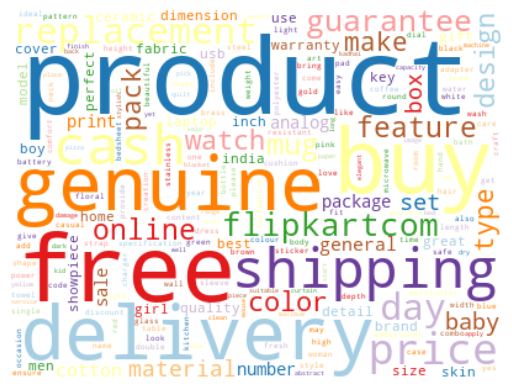

In [54]:
# creation of wordcloud
wcloud_fig = WordCloud(stopwords=set(wordcloud.STOPWORDS),background_color = 'white',
                      colormap='Paired', width=400, height=300).generate_from_frequencies(text_total)

# plotting the wordcloud
plt.axis('off')
plt.imshow(wcloud_fig, interpolation  = 'bilinear')
plt.show()

Nous remarquons encore une fois que le mot "product" est le plus présent, ensuite 'free', 'delivery' ,''replacement', ....

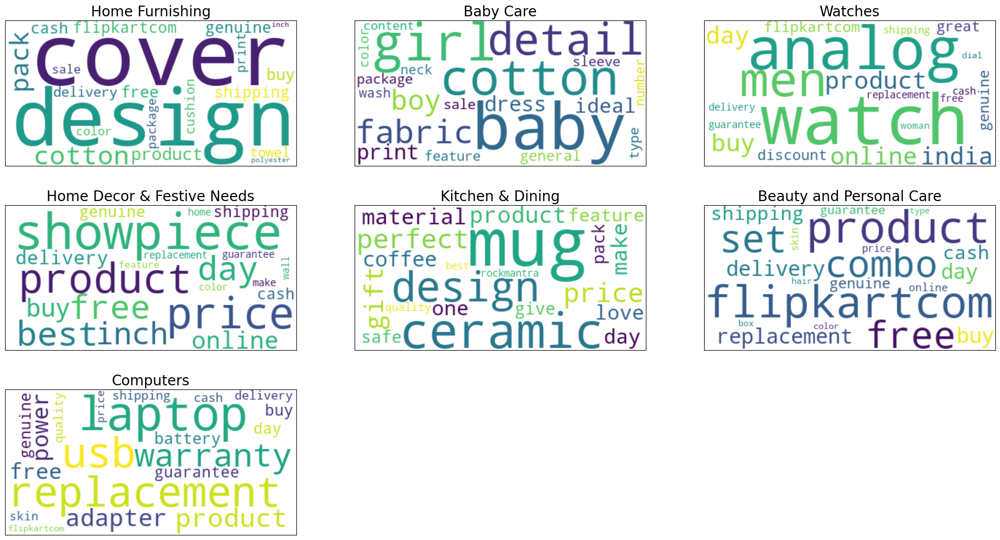

In [55]:
plt.figure(3, figsize=(25,18))
plt.style.use('fast')
for i in range(len(data['Cluster_cat'].unique())) :
  df = data[data['Cluster_cat']==i].groupby(['Cluster_cat'])['lemmatizer'].transform(lambda x : ' '.join(x))[0:1].tolist()[0]
  text_total_cat = word_count(df)

  # creation of wordcloud
  wcloud_fig = WordCloud(stopwords=set(wordcloud.STOPWORDS),
                        colormap='viridis', max_words=20, background_color="white").generate_from_frequencies(text_total_cat)

  # plotting the wordcloud
  ax = plt.subplot(4, 3, i+1)
  # plt.text(100,-10,data[['cat_niveau_1']][data['Cluster_cat']==i].values[0][0],fontsize=18)
  # plt.set_title("The Title")
  plt.title(data[['cat_niveau_1']][data['Cluster_cat']==i].values[0][0],fontsize=20)
  plt.imshow(wcloud_fig, interpolation  = 'bilinear')
  # plt.axis('off')
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)

plt.show()

In [56]:
import plotly.express as px

In [57]:
# Le nombre de mot par ligne
data['word_length'] = data['lemmatizer'].apply(lambda x:len(x.split()))

Data_word_length = data.groupby(['cat_niveau_1']).agg({"word_length" : "sum"}).reset_index()

fig = px.bar(Data_word_length, y='cat_niveau_1', x='word_length', text_auto='.3s', color = 'cat_niveau_1',
            title="La longueur des mots par catégorie")
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()


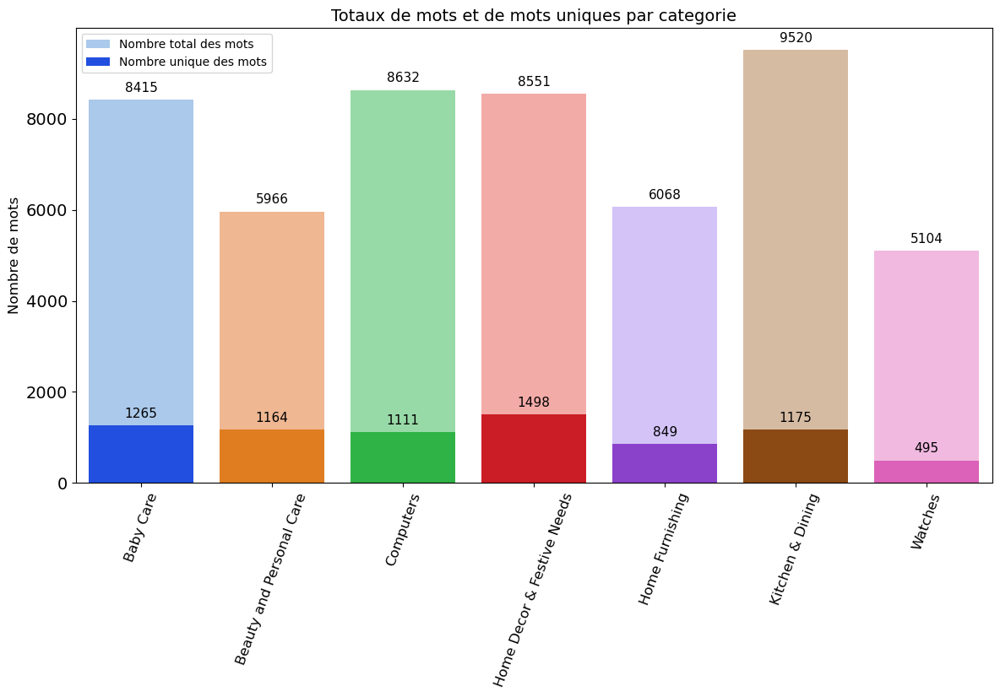

In [58]:
# grouper par catégorie et concaténer les desciptions de la colonne 'lemmatizer'
df = data.groupby('cat_niveau_1')['lemmatizer'].apply(lambda x: "%s" % ' '.join(x))

df = pd.DataFrame(df, columns=['lemmatizer'])
df['nb_word_unique'] = df['lemmatizer'].apply(lambda x:len(np.unique(x.split())))
df = pd.merge(df, Data_word_length, on='cat_niveau_1', how='right')

x = df['cat_niveau_1']
y = df['word_length']
y_bis = df['nb_word_unique']

fig, ax = plt.subplots(figsize=(14,7))

sns.barplot(x=x, y=y, data=df, color='blue',label = 'Nombre total des mots', palette='pastel')
sns.barplot(x=x, y=y_bis, data=df, color='red', label = 'Nombre unique des mots', palette='bright')

# Ajouter les annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points',
                fontsize = 11,
                #  rotation= 70,
                )

ax.set_ylabel('Nombre de mots', fontsize=12)

plt.xticks(rotation= 70 , fontsize=12)
plt.yticks(fontsize=14)
plt.xlabel('', fontsize=14)

plt.title('Totaux de mots et de mots uniques par categorie', fontsize=14)
plt.legend()

plt.show()

In [59]:
transformation = []
for i, el  in enumerate(matrix_cat.todense()[4,:].tolist()[0]):
    if el !=0:
        transformation.append((tfidf.get_feature_names_out()[i], el))
pd.DataFrame(transformation, columns=['mot', 'tfidf']).sort_values(by='tfidf', ascending=False).head(10)

,mot,tfidf
58,sheet,0.526946
30,jaipur,0.298611
1,bedsheet,0.267861
50,pillow,0.264180
0,bed,0.246463
23,flat,0.220928
32,king,0.214289
13,cover,0.180150
52,print,0.160889
10,cotton,0.153870


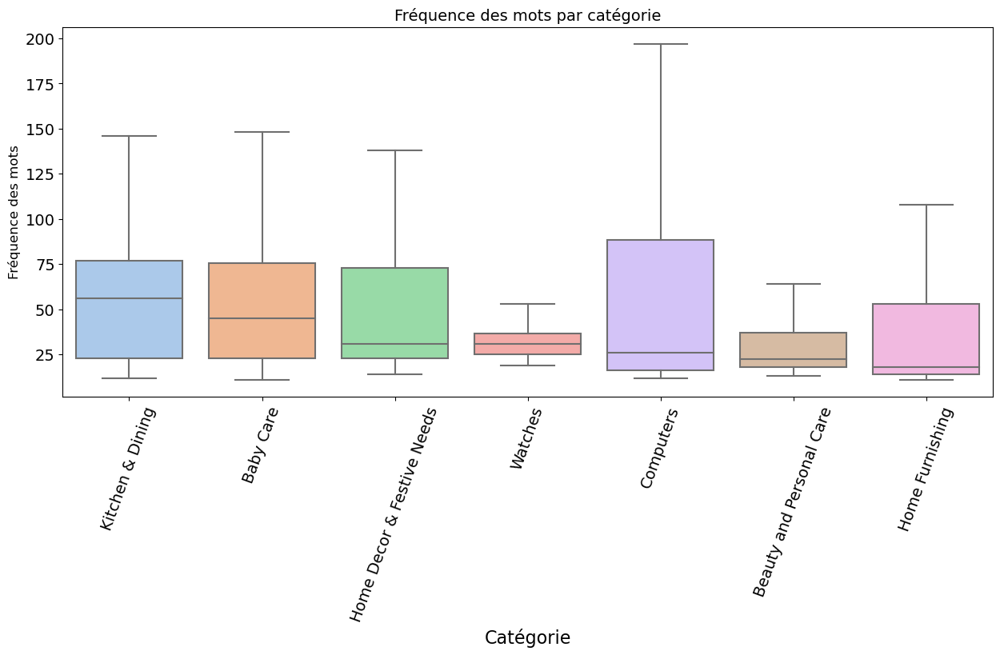

In [60]:
fig, ax = plt.subplots()

grouped = data.loc[:,['cat_niveau_1', 'word_length']] \
    .groupby(['cat_niveau_1']) \
    .median() \
    .sort_values(by='word_length', ascending=False).head(20)

sns.boxplot(x= 'cat_niveau_1', y = 'word_length', data = data, \
            order=grouped.index, showfliers=False, palette='pastel')

fig.set_size_inches(15, 6)
ax.set_ylabel('Fréquence des mots', fontsize=12)
ax.set_title("Fréquence des mots par catégorie", fontsize=14)

plt.xticks(rotation=70, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Catégorie', fontsize=16)
plt.show()

In [61]:
#statistiques
print('Le nombre moyen de mots dans une description:', data['word_length'].mean().round(2))
print('Le nombre median de mots dans une description:', data['word_length'].median())
print('Le nombre minimum de mots dans une description:', data['word_length'].min())
print('Le nombre maximum de mots dans une description:', data['word_length'].max())

Le nombre moyen de mots dans une description: 49.77
Le nombre median de mots dans une description: 31.0
Le nombre minimum de mots dans une description: 11
Le nombre maximum de mots dans une description: 353


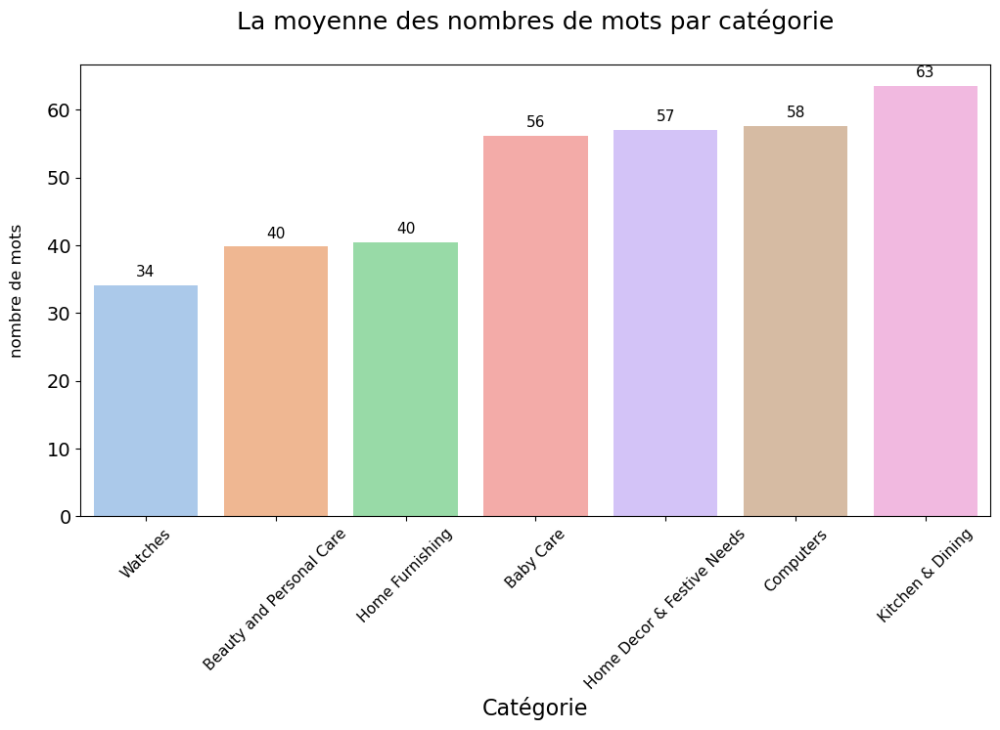

In [62]:
data_mean_word = data.copy()

data_mean_word = data_mean_word.groupby(['cat_niveau_1']).agg({"word_length" :\
                                                               "mean"}).reset_index()
data_mean_word = data_mean_word.sort_values(by='word_length', ascending=True)

x_frequency = data_mean_word['cat_niveau_1']
y_frequency = data_mean_word['word_length']

fig, ax = plt.subplots(figsize=(12,6))

# ax = sns.lineplot(x= x_frequency, y = y_frequency, data=data_mean_word, palette="pastel",marker='o')
ax = sns.barplot(x=x_frequency, y=y_frequency, data=data_mean_word,
                 palette="pastel")

# Ajouter les annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points',
                fontsize = 11,
                #  rotation='vertical',
                )

ax.set_ylabel('nombre de mots\n', fontsize=12)

plt.xticks(rotation= 45 , fontsize=11)
plt.yticks(fontsize=14)
plt.xlabel('Catégorie', fontsize=16)

plt.title('La moyenne des nombres de mots par catégorie\n', fontsize=18)

plt.show()


In [63]:
df_tfidf = pd.DataFrame(matrix_cat.toarray(), columns=tfidf.get_feature_names_out())
df_tfidf

,aaa,aapno,aari,aarika,ability,abklgrngrngrn,abklplplpnk,abklplpnkpnk,able,abode,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1046,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1048,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [64]:
df_tfidf.shape

(1050, 4776)

In [65]:
!pip install threadpoolctl==3.1.0

In [66]:
from sklearn.manifold import TSNE

In [67]:
X = df_tfidf.values
X_tsne = TSNE(n_components=2).fit_transform(X)

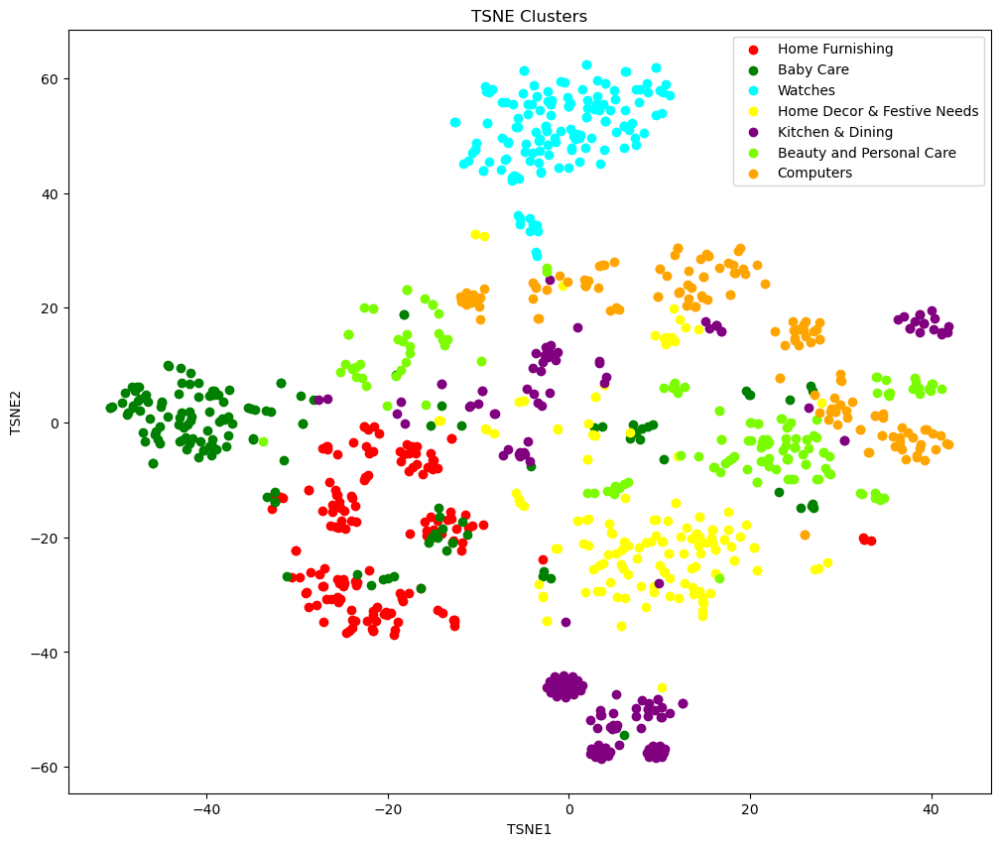

In [68]:
fig = plt.figure(figsize=(12,10))


target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append(data['cat_niveau_1'][data['Cluster_cat']==i].unique()[0])
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne[data['Cluster_cat']==i,0],
              y = X_tsne[data['Cluster_cat']==i,1], color=color,
              label=target_name)

plt.legend()
# plt.grid()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters')



plt.show()



> Segmentation K-Means - TF-IDF (Lémmatisation)



In [69]:
tfidf = TfidfVectorizer()

X = tfidf.fit_transform(data['lemmatizer'])

In [70]:
df_tfidf = pd.DataFrame(X.toarray(), columns=tfidf.get_feature_names_out())
df_tfidf

,aaa,aapno,aari,aarika,ability,abklgrngrngrn,abklplplpnk,abklplpnkpnk,able,abode,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1046,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1048,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [71]:
!pip install yellowbrick

In [72]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

In [73]:
from sklearn.datasets import make_blobs

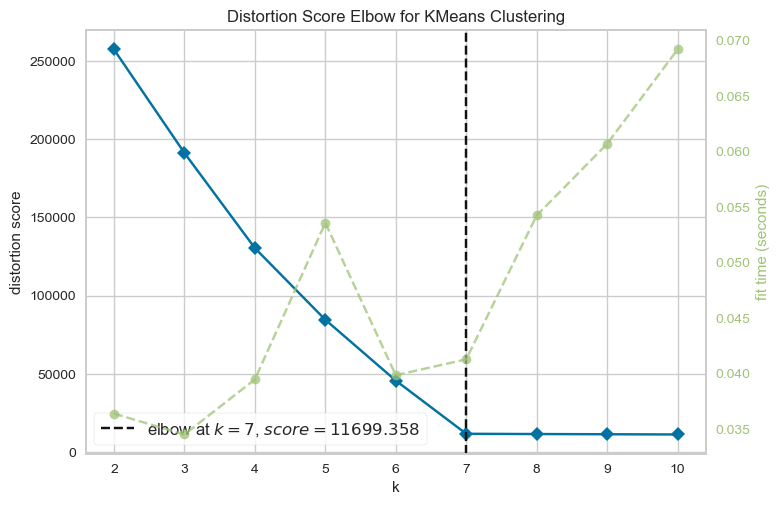

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [94]:
# Generate synthetic dataset with 7 random clusters
X, y = make_blobs(n_samples=1000, n_features=12, centers=7, random_state=0)

# Instantiate the clustering model and visualizer
visualizer = KElbowVisualizer(KMeans(),K=(4,12))

visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [95]:
X = df_tfidf.values

X_tsne = TSNE(n_components=2,random_state=7).fit_transform(X)

In [76]:
# X = df_tfidf.values
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne)

array([[32.092728, 49.075768, 20.380909, ..., 48.559525, 62.626194,
        33.409435],
       [39.042213, 39.117214, 27.86524 , ..., 48.765636, 71.60299 ,
        27.759542],
       [38.384285, 37.529583, 30.233767, ..., 46.502033, 71.615776,
        25.058002],
       ...,
       [25.710987, 45.192726, 45.582798, ..., 23.072739, 60.987885,
        15.66601 ],
       [25.761532, 44.422863, 43.362377, ..., 25.472458, 61.181904,
        15.877924],
       [25.546604, 45.12206 , 44.92531 , ..., 23.69469 , 60.875286,
        15.84185 ]], dtype=float32)

In [77]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance

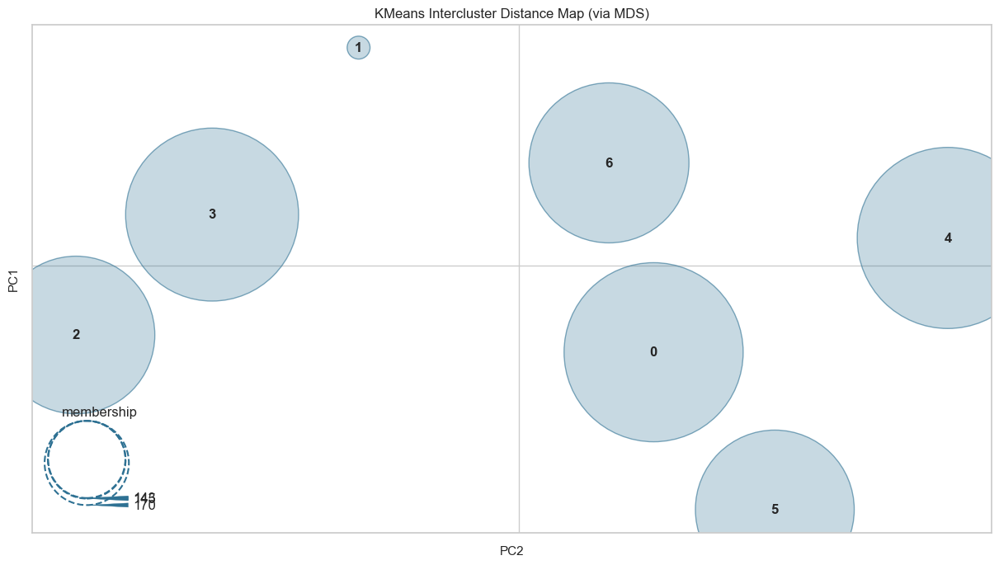

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [78]:
fig = plt.figure(figsize=(15,8))

K = visualizer.elbow_value_
distance_visualizer = InterclusterDistance(kmeans)
distance_visualizer.fit(X_tsne)
distance_visualizer.show()

In [79]:
data['Cluster'] = kmeans.labels_

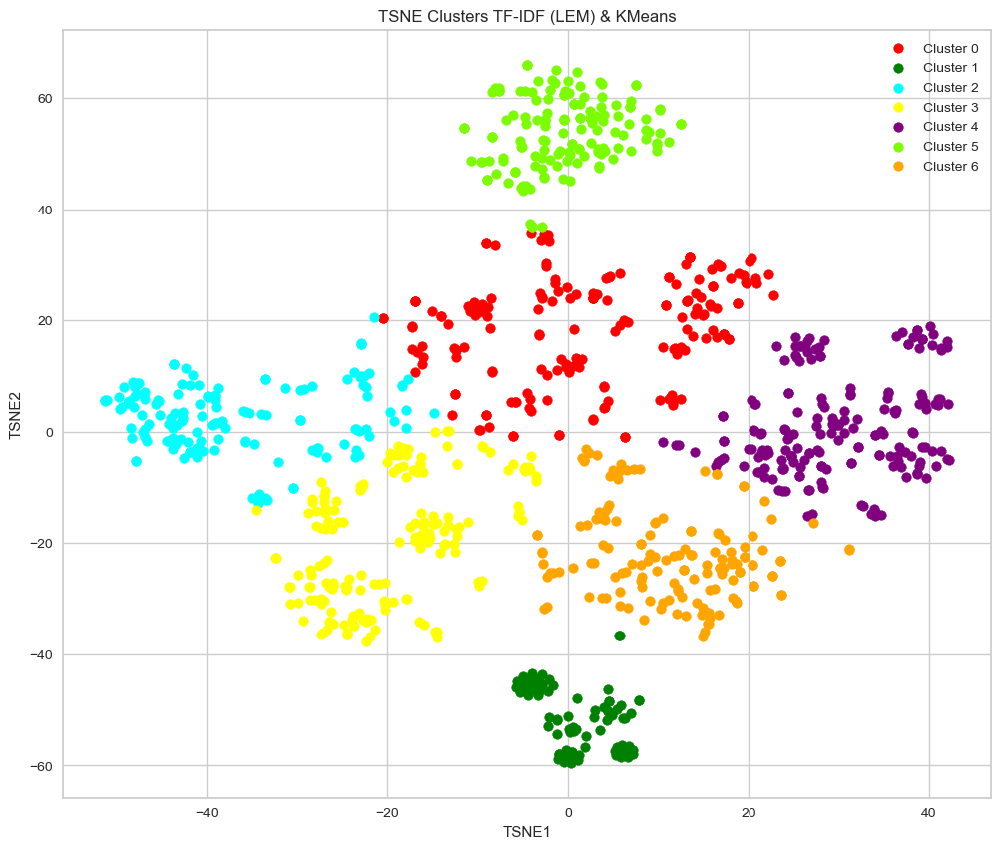

In [80]:
fig = plt.figure(figsize=(12,10))



target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne[data['Cluster']==i,0], y = X_tsne[data['Cluster']==i,1], color=Colors[i], label=target_name)


plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters TF-IDF (LEM) & KMeans')


plt.show()

In [81]:
data.columns

Index(['Unnamed: 0', 'uniq_id', 'product_url', 'product_name',
       'discounted_price', 'image', 'description', 'cat_niveau_1',
       'Cluster_cat', 'cleaned_description', 'lemmatizer', 'tokenized',
       'stemmer', 'tokenize_stem', 'bigram', 'bigram_trigram', 'Cluster',
       'group', 'word_length', 'Color'],
      dtype='object')

In [82]:
from sklearn.metrics import adjusted_rand_score

In [83]:
%time
print('ARI score suite à la lémmatisation & TF-IDF :',adjusted_rand_score(data['Cluster'], data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score suite à la lémmatisation & TF-IDF : 0.4691505881059818




> Segmentation K-Means - TF-IDF (Stemming)



In [84]:
tfidf_stem = TfidfVectorizer()

X_stem = tfidf_stem.fit_transform(data['stemmer'])

In [85]:
df_tfidf_stem = pd.DataFrame(X_stem.toarray(),
                             columns=tfidf_stem.get_feature_names_out())
df_tfidf_stem

,aaa,aapno,aari,aarika,abil,abkl_grn_grn_grn,abkl_pl_pl_pnk,abkl_pl_pnk_pnk,abl,abod,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1046,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1048,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [86]:
X_stem = df_tfidf_stem.values
X_tsne_stem = TSNE(n_components=2,random_state=9).fit_transform(X_stem)

In [87]:
# X = df_tfidf.values
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_stem)
data['Cluster'] = kmeans.labels_

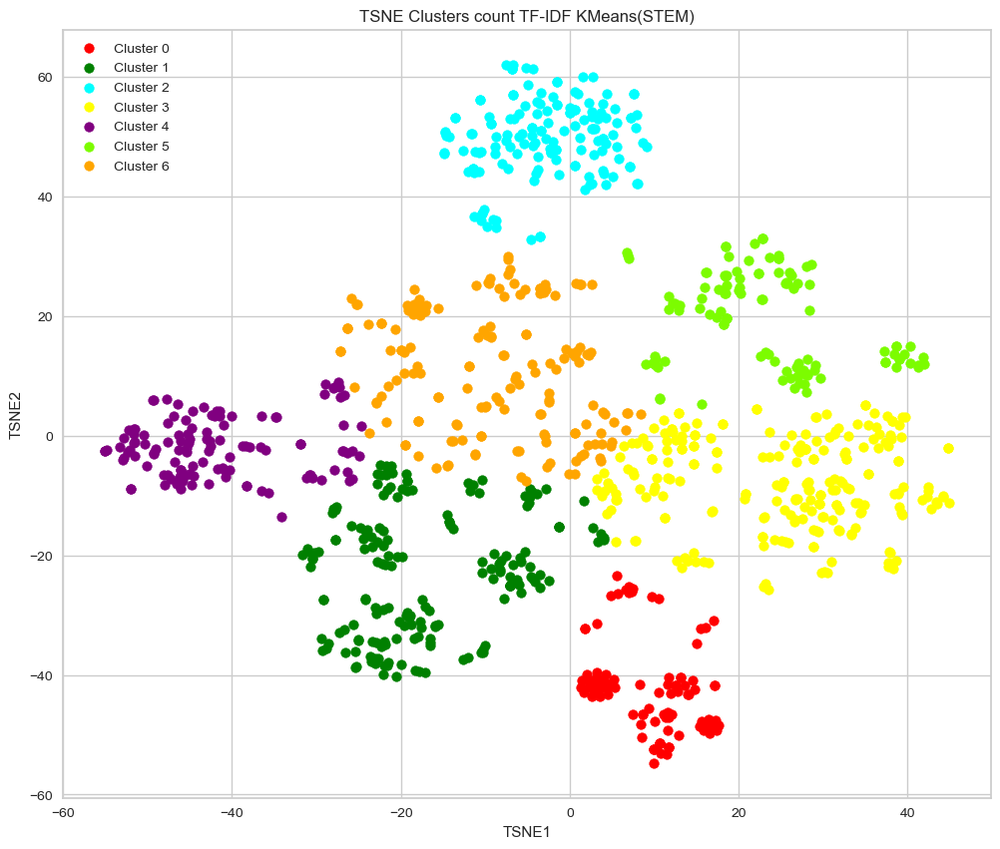

In [88]:
fig = plt.figure(figsize=(12,10))


target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(
              x = X_tsne_stem[data['Cluster']==i,0],
              y = X_tsne_stem[data['Cluster']==i,1],
              color=Colors[i], label=target_name
            )


plt.legend(loc = 'upper left')

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters count TF-IDF KMeans(STEM)')


plt.show()

In [91]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [102]:
kmeans.labels_

array([1, 1, 1, ..., 3, 3, 3])

Matrice de confusion en forme de heatmap


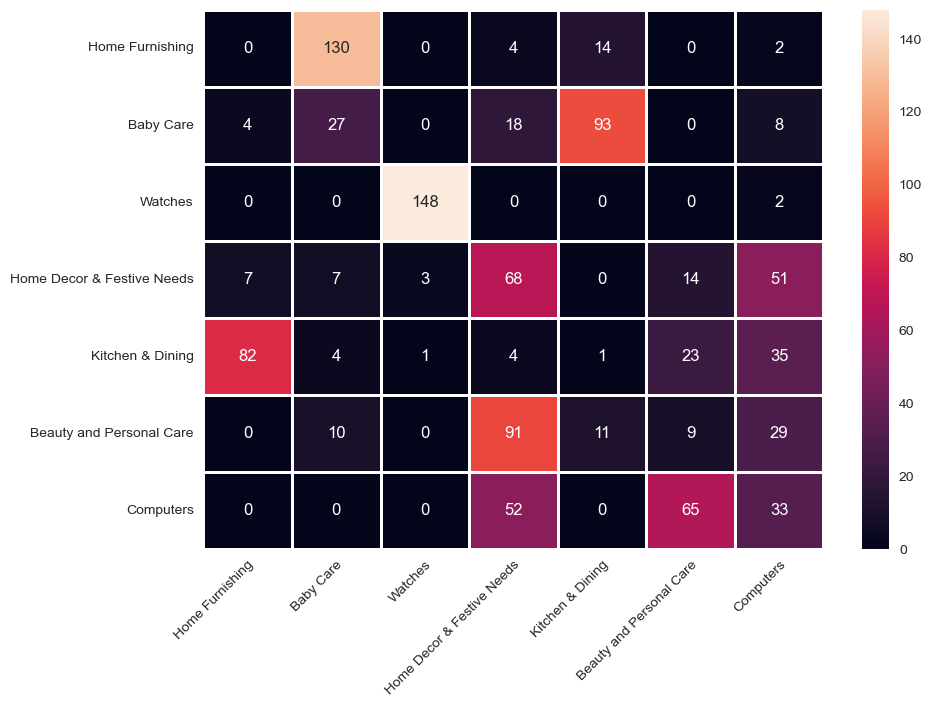

Rapport de classification
                            precision    recall  f1-score   support

           Home Furnishing       0.00      0.00      0.00       150
                 Baby Care       0.15      0.18      0.16       150
                   Watches       0.97      0.99      0.98       150
Home Decor & Festive Needs       0.29      0.45      0.35       150
          Kitchen & Dining       0.01      0.01      0.01       150
  Beauty and Personal Care       0.08      0.06      0.07       150
                 Computers       0.21      0.22      0.21       150

                  accuracy                           0.27      1050
                 macro avg       0.24      0.27      0.26      1050
              weighted avg       0.24      0.27      0.26      1050



In [107]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_tf = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_classes = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_tf ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))

In [108]:
%time
print('ARI score TF-IDF (stemming) : ',adjusted_rand_score(data['Cluster'],
                                                    data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score TF-IDF (stemming) :  0.4091736029814129




> Segmentation K-Means - CountVectorizer (Lemmatisation)



In [109]:
count_vec = CountVectorizer()
x = count_vec.fit_transform(data['lemmatizer'])

In [110]:
df_count_vec = pd.DataFrame(x.toarray(),
                            columns=count_vec.get_feature_names_out())
df_count_vec

,aaa,aapno,aari,aarika,ability,abklgrngrngrn,abklplplpnk,abklplpnkpnk,able,abode,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1046,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1047,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1048,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


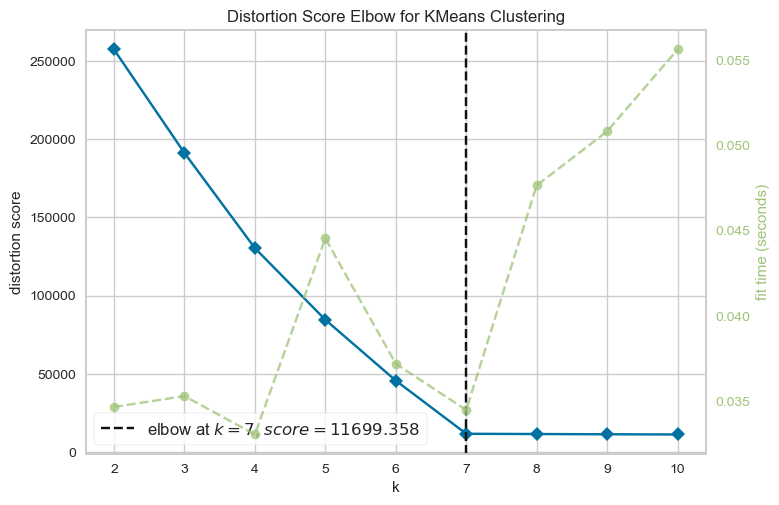

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [112]:
# Generate synthetic dataset with 7 random clusters
X, y = make_blobs(n_samples=1000, n_features=12, centers=7, random_state=0)

# Instantiate the clustering model and visualizer
visualizer = KElbowVisualizer(KMeans(),K=(4,12))

visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [113]:
X_count_vec = df_count_vec.values
X_tsne_vec = TSNE(n_components=2,random_state=9).fit_transform(X_count_vec)

In [114]:
# X = df_count_vec.values
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_vec)

array([[18.563736 , 84.75924  , 57.658833 , ..., 33.32866  , 47.520294 ,
        32.40199  ],
       [14.936032 , 69.44147  , 30.65294  , ..., 10.848579 , 34.83827  ,
        53.144474 ],
       [16.305408 , 71.79997  , 32.196507 , ...,  8.400428 , 37.33453  ,
        54.500523 ],
       ...,
       [34.959156 , 35.61538  , 34.899788 , ..., 51.347874 ,  6.9911423,
        44.89981  ],
       [35.364185 , 34.147068 , 32.444862 , ..., 50.615536 ,  5.2921453,
        47.38233  ],
       [34.7793   , 35.382027 , 33.99576  , ..., 50.83052  ,  6.1702385,
        45.535793 ]], dtype=float32)

In [115]:
data['Cluster'] = kmeans.labels_

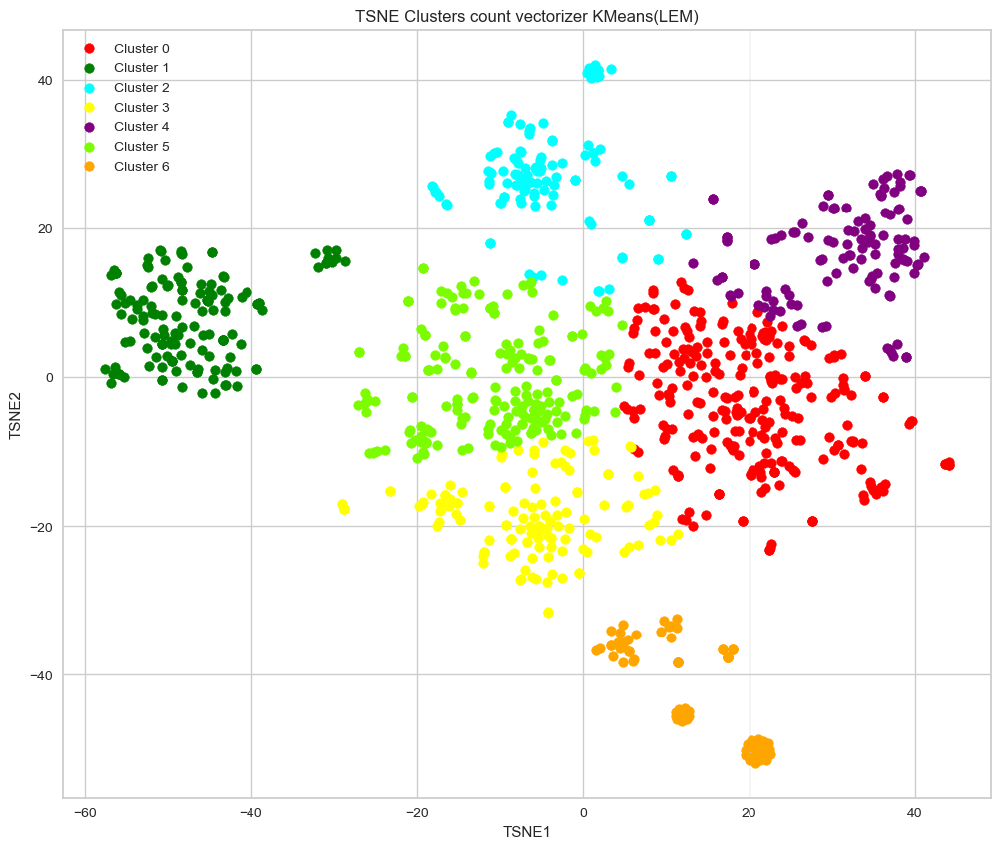

In [116]:
fig = plt.figure(figsize=(12,10))


target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_vec[data['Cluster']==i,0], y = X_tsne_vec[data['Cluster']==i,1], color=Colors[i], label=target_name)


plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters count vectorizer KMeans(LEM)')



plt.show()

In [117]:
%time
print('ARI score CountVectorizer (Lemmatizer):',
            adjusted_rand_score(data['Cluster'],data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score CountVectorizer (Lemmatizer): 0.4494055969112318


Matrice de confusion en forme de heatmap


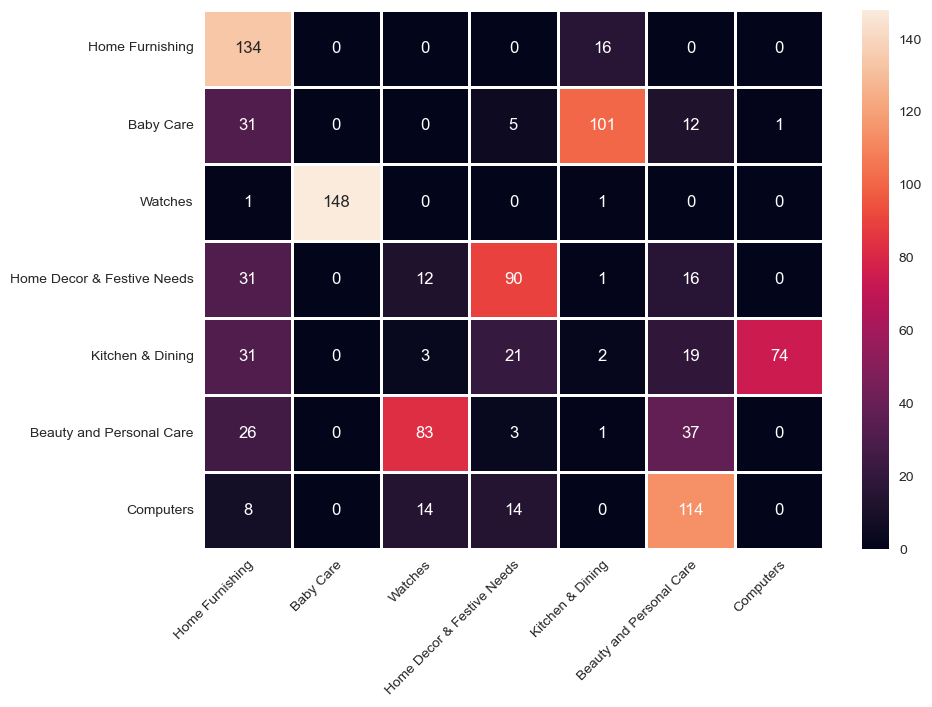

Rapport de classification
                            precision    recall  f1-score   support

           Home Furnishing       0.51      0.89      0.65       150
                 Baby Care       0.00      0.00      0.00       150
                   Watches       0.00      0.00      0.00       150
Home Decor & Festive Needs       0.68      0.60      0.64       150
          Kitchen & Dining       0.02      0.01      0.01       150
  Beauty and Personal Care       0.19      0.25      0.21       150
                 Computers       0.00      0.00      0.00       150

                  accuracy                           0.25      1050
                 macro avg       0.20      0.25      0.22      1050
              weighted avg       0.20      0.25      0.22      1050



In [118]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_ct = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_classes = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_ct ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))



> Segmentation K-Means - CountVectorizer (Stemming)


In [119]:
count_vec = CountVectorizer()
x = count_vec.fit_transform(data['stemmer'])

In [120]:
df_count_vec = pd.DataFrame(x.toarray(), columns=count_vec.get_feature_names_out())
df_count_vec

,aaa,aapno,aari,aarika,abil,abkl_grn_grn_grn,abkl_pl_pl_pnk,abkl_pl_pnk_pnk,abl,abod,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1046,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1047,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1048,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [121]:
X_count_vec = df_count_vec.values
X_tsne_vec = TSNE(n_components=2,random_state=9).fit_transform(X_count_vec)

In [122]:
# X = df_count_vec.values
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_vec)

array([[26.802986, 84.216156, 18.916428, ..., 45.148037, 35.678223,
        46.84181 ],
       [11.13926 , 68.261765, 16.880783, ..., 31.624506, 53.871452,
        45.894104],
       [ 8.564136, 70.85117 , 17.075733, ..., 33.91654 , 53.958153,
        47.503166],
       ...,
       [49.869484, 39.988663, 30.41854 , ..., 12.089098, 37.133656,
         8.469596],
       [48.547825, 42.727097, 28.505047, ..., 13.094564, 34.598255,
         7.580585],
       [49.23213 , 40.899483, 29.622282, ..., 12.153513, 36.383522,
         8.291046]], dtype=float32)

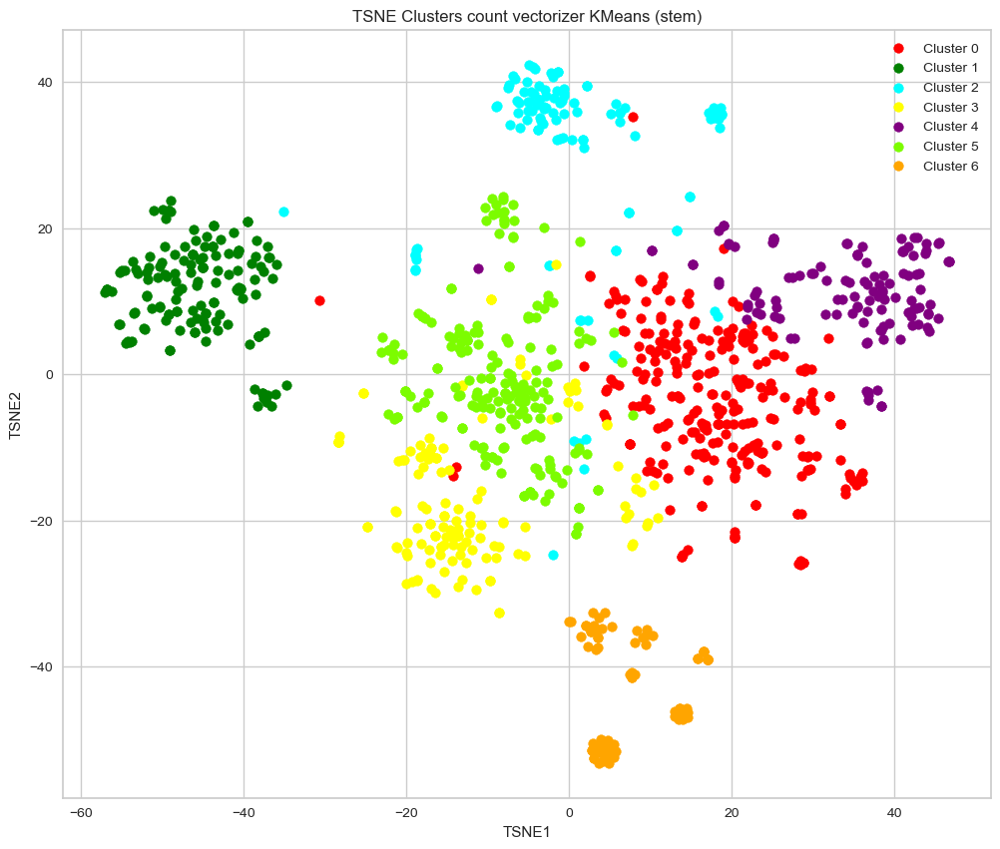

In [123]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_vec[data['Cluster']==i,0], y = X_tsne_vec[data['Cluster']==i,1], color=Colors[i], label=target_name)

plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters count vectorizer KMeans (stem)')

plt.show()

In [124]:
data['Cluster'] = kmeans.labels_

In [125]:
data['Cluster'].nunique()

7

In [126]:
data['Cluster'].unique()

array([2, 0, 1, 4, 6, 5, 3])

In [94]:
%time
print('ARI score CountVectorizer (Stemming): ',
      adjusted_rand_score(data['Cluster'], data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score CountVectorizer (Stemming):  0.4431401771832997


Matrice de confusion en forme de heatmap


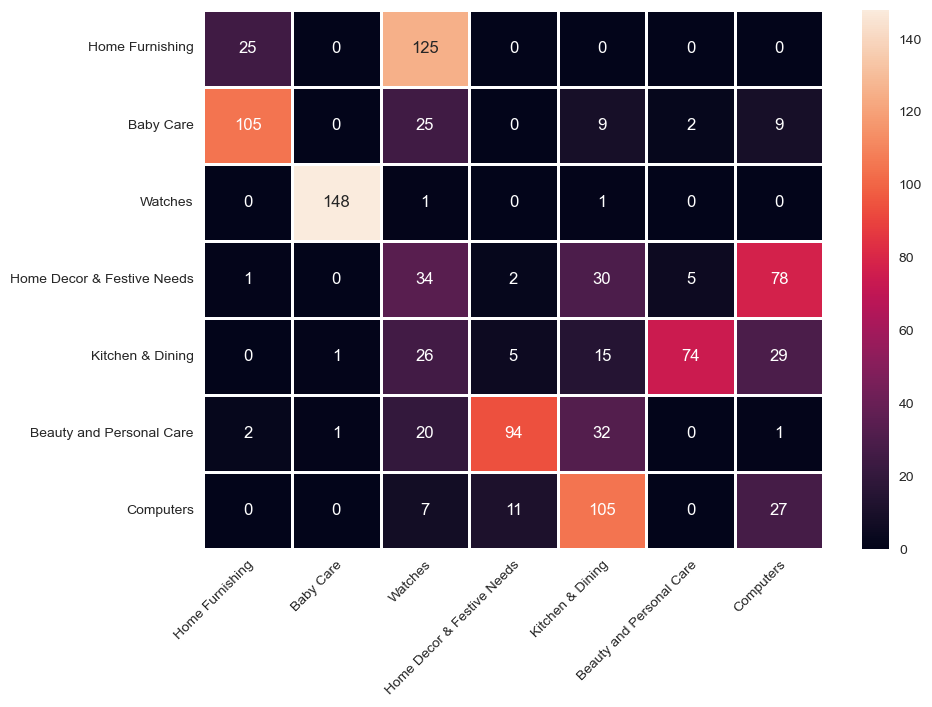

Rapport de classification
                            precision    recall  f1-score   support

           Home Furnishing       0.19      0.17      0.18       150
                 Baby Care       0.00      0.00      0.00       150
                   Watches       0.00      0.01      0.01       150
Home Decor & Festive Needs       0.02      0.01      0.02       150
          Kitchen & Dining       0.08      0.10      0.09       150
  Beauty and Personal Care       0.00      0.00      0.00       150
                 Computers       0.19      0.18      0.18       150

                  accuracy                           0.07      1050
                 macro avg       0.07      0.07      0.07      1050
              weighted avg       0.07      0.07      0.07      1050



In [127]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_tf_stem = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_classes = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_tf_stem ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))

### **Word2Vec Model**


In [95]:
!pip install --upgrade gensim

In [128]:
w2v_size = 300
w2v_window = 5
w2v_min_count = 1
w2v_epochs = 100
maxlen = 24 # adapt to length of sentences
sentences = data['tokenized'].to_list()

In [129]:
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [130]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                                vector_size=w2v_size,
                                                seed=42,
                                                workers=1)
# workers=multiprocessing.cpu_count())
w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 4583
Word2Vec trained


In [131]:
vocab_len = len(w2v_words)
print('Taille du vocabulaire:' , vocab_len )

Taille du vocabulaire: 4583


In [132]:
w2v_model.wv.most_similar("computer")

[('shopfloorxyz', 0.8735591173171997),
 ('vacuum', 0.8174309730529785),
 ('processget', 0.8059695363044739),
 ('crevice', 0.726815402507782),
 ('beloved', 0.7259331345558167),
 ('port', 0.7227092981338501),
 ('attachment', 0.7208186388015747),
 ('cleaning', 0.7183982133865356),
 ('connect', 0.7120555639266968),
 ('sfvc', 0.7107047438621521)]

In [133]:
w2v_model.wv.most_similar("watch")

[('analog', 0.692004382610321),
 ('pcw', 0.6588686108589172),
 ('men', 0.6574660539627075),
 ('pccc', 0.6516599059104919),
 ('decker', 0.6439602971076965),
 ('gnlbbl', 0.6306036114692688),
 ('bdblue', 0.6200136542320251),
 ('lcs', 0.6197222471237183),
 ('stylo', 0.613345742225647),
 ('barbie', 0.6123539209365845)]

In [134]:
w2v_model.wv.most_similar("dress")

[('gather', 0.8173402547836304),
 ('aline', 0.741651713848114),
 ('waist', 0.7224770784378052),
 ('empire', 0.6924707889556885),
 ('frock', 0.6649324893951416),
 ('toddla', 0.6571810245513916),
 ('garment', 0.6161479949951172),
 ('baby', 0.5873481035232544),
 ('sleepsuit', 0.5850168466567993),
 ('moshai', 0.5827808976173401)]

In [135]:
import tensorflow as tf

In [136]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from transformers import BertTokenizer
from transformers import TFAutoModel

In [137]:
# Préparation des sentences (tokenization)
print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post')

num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 4584


In [138]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
w2v_size = 300
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0

for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]

word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (4584, 300)


In [139]:
from tensorflow.keras.layers import *

In [140]:
from tensorflow.keras.models import Model

In [141]:
# Création du modèle
input = Input(shape=(len(x_sentences),maxlen),dtype='float64')
word_input = Input(shape=(maxlen,),dtype='float64')
word_embedding = Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec = GlobalAveragePooling1D()(word_embedding)
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding (Embedding)       (None, 24, 300)           1375200   
                                                                 
 global_average_pooling1d (  (None, 300)               0         
 GlobalAveragePooling1D)                                         
                                                                 
Total params: 1375200 (5.25 MB)
Trainable params: 1375200 (5.25 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [142]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 2ms/step


(1050, 300)

In [143]:
X_Word2Vec = embeddings
X_tsne_Word2Vec = TSNE(n_components=2,random_state=9).fit_transform(embeddings)

In [144]:
X_tsne_Word2Vec

array([[ 14.517837, -21.812983],
       [ 18.075512, -18.735815],
       [ 17.885092, -18.740074],
       ...,
       [-20.89154 ,  17.851141],
       [-20.48424 ,  18.730558],
       [-20.821692,  17.932396]], dtype=float32)

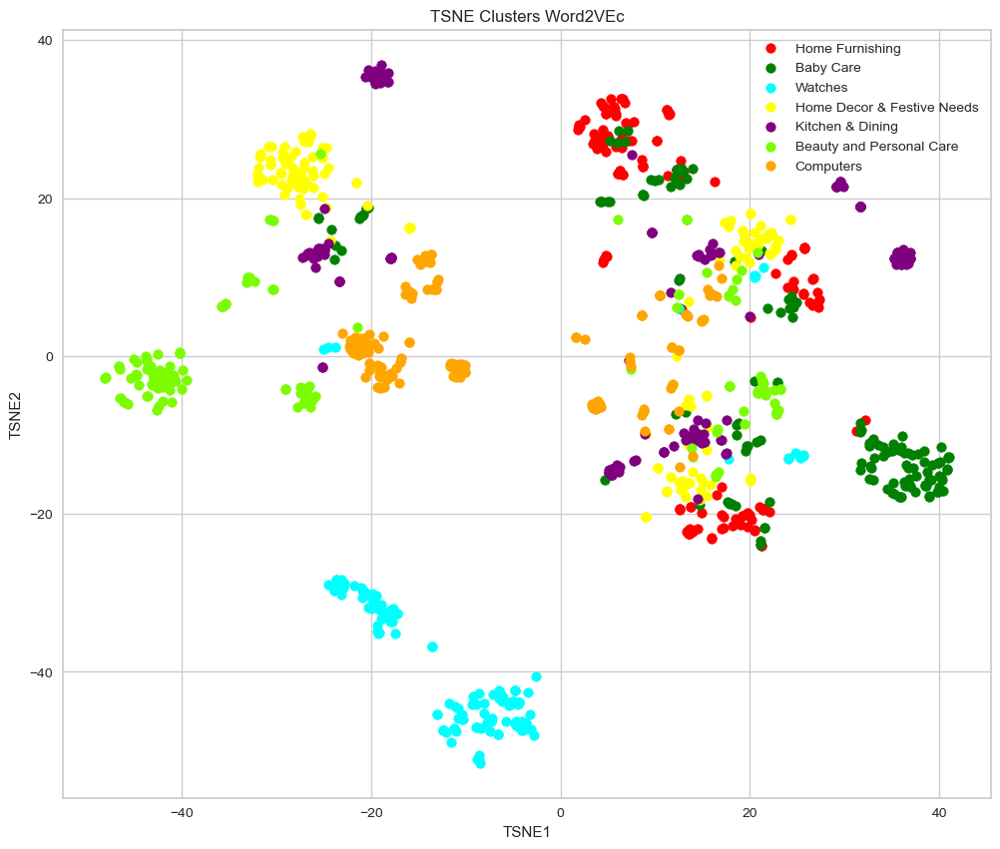

In [145]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append(data['cat_niveau_1'][data['Cluster_cat']==i].unique()[0])
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_Word2Vec[data['Cluster_cat']==i,0],
              y = X_tsne_Word2Vec[data['Cluster_cat']==i,1], color=color,
              label=target_name)

plt.legend()
# plt.grid()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters Word2VEc')



plt.show()

In [146]:
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_Word2Vec)

array([[48.781734 ,  9.480785 , 47.38242  , ..., 32.560425 , 22.603456 ,
        34.874348 ],
       [50.86725  ,  7.2687016, 45.03749  , ..., 37.237312 , 18.26402  ,
        31.162294 ],
       [50.690334 ,  7.1843276, 44.997505 , ..., 37.079266 , 18.448746 ,
        31.195763 ],
       ...,
       [20.749813 , 46.61775  , 29.337738 , ..., 58.631413 , 64.85553  ,
        44.043823 ],
       [21.718971 , 46.886055 , 28.736845 , ..., 59.44477  , 64.93754  ,
        43.765247 ],
       [20.852892 , 46.61725  , 29.250141 , ..., 58.701725 , 64.83443  ,
        43.985332 ]], dtype=float32)

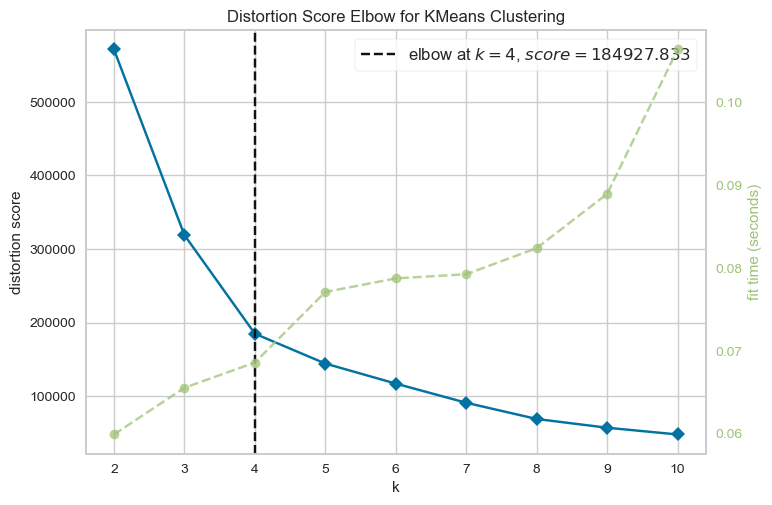

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [115]:
# Instantiate the clustering model and visualizer
visualizer = KElbowVisualizer(KMeans(),K=(4,12))

visualizer.fit(X_tsne_Word2Vec)    # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

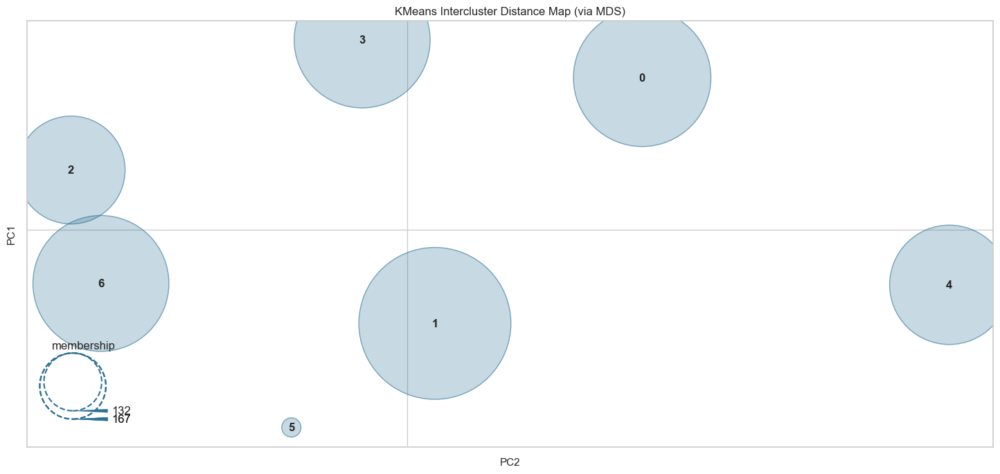

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [147]:
fig = plt.figure(figsize=(18,8))

K = visualizer.elbow_value_
distance_visualizer = InterclusterDistance(kmeans)
distance_visualizer.fit(X)
distance_visualizer.show()

In [148]:
data['Cluster'] = kmeans.labels_

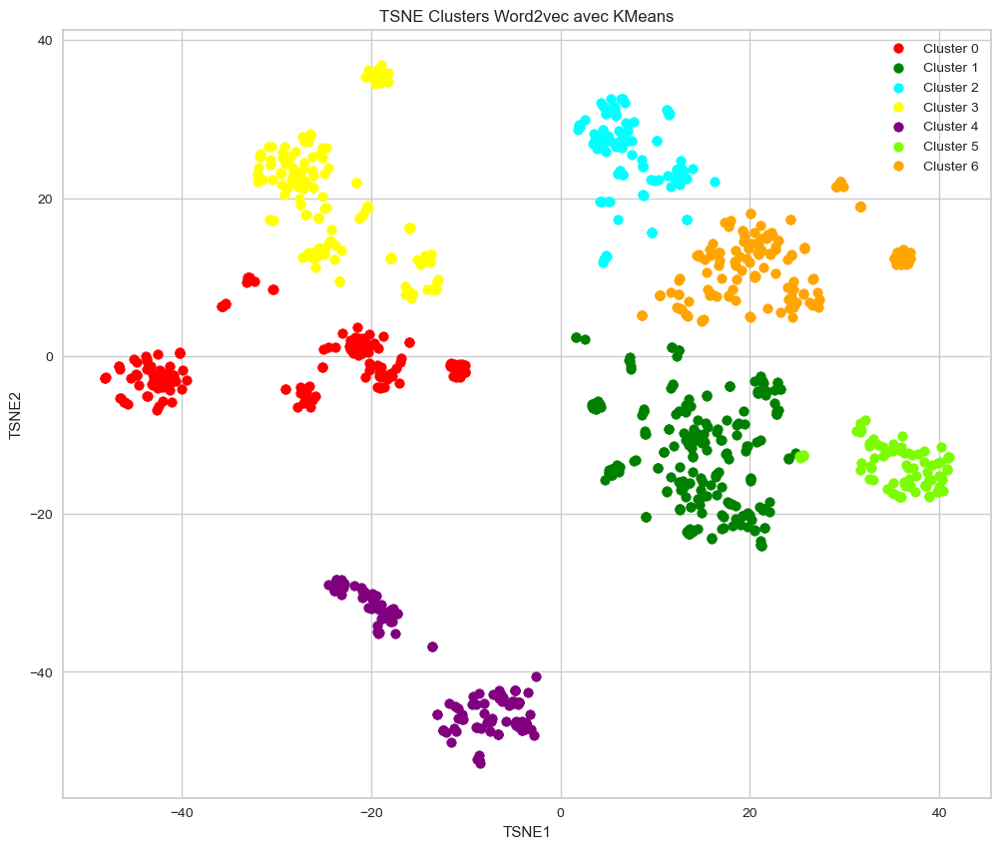

In [118]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_Word2Vec[data['Cluster']==i,0], y = X_tsne_Word2Vec[data['Cluster']==i,1], color=Colors[i], label=target_name)

plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters Word2vec avec KMeans')

plt.show()

In [149]:
%time
print('ARI score Word2Vec (LEM) : ',adjusted_rand_score(data['Cluster'], data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score Word2Vec (LEM) :  0.30130881998458964


In [150]:
print( 'les scores ARI :')
print ( '\033[1m','\033[0;31m','TF-IDF + LEM    = 0.48', '\033[0m')
print ( '  TF-IDF + STEM   = 0.45')
print ( '  CountVec + LEM  = 0.43')
print ( '  CountVec + STEM = 0.43')
print ( '  Word2Vec        = 0.30')


les scores ARI :
  TF-IDF + LEM    = 0.48 
  TF-IDF + STEM   = 0.45
  CountVec + LEM  = 0.43
  CountVec + STEM = 0.43
  Word2Vec        = 0.30


Matrice de confusion en forme de heatmap


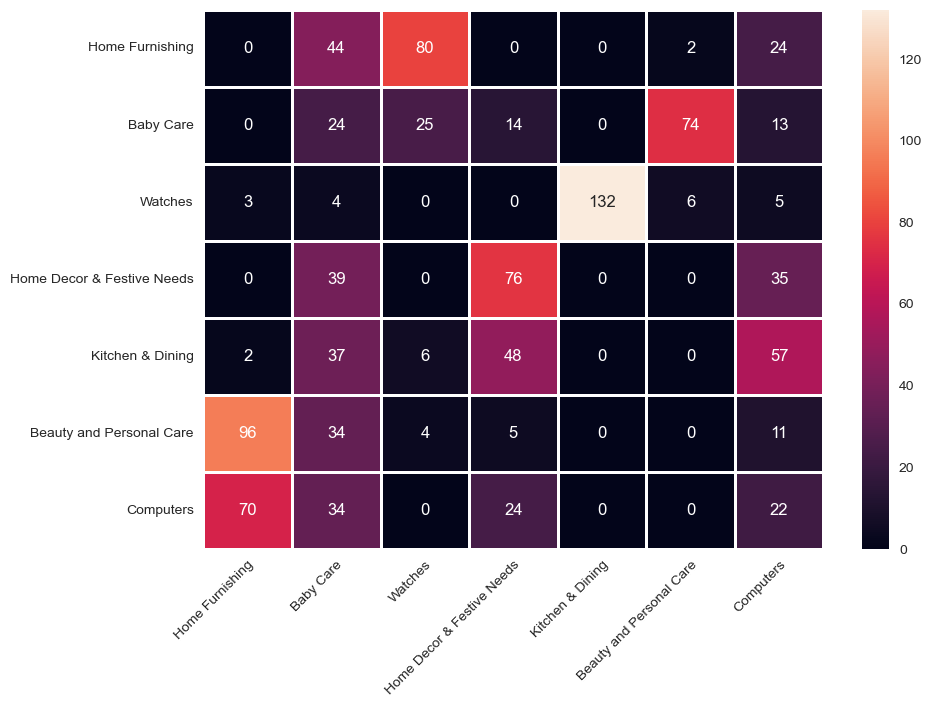

Rapport de classification
                            precision    recall  f1-score   support

           Home Furnishing       0.00      0.00      0.00       150
                 Baby Care       0.11      0.16      0.13       150
                   Watches       0.00      0.00      0.00       150
Home Decor & Festive Needs       0.46      0.51      0.48       150
          Kitchen & Dining       0.00      0.00      0.00       150
  Beauty and Personal Care       0.00      0.00      0.00       150
                 Computers       0.13      0.15      0.14       150

                  accuracy                           0.12      1050
                 macro avg       0.10      0.12      0.11      1050
              weighted avg       0.10      0.12      0.11      1050



In [151]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_w2v = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_classes = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_w2v ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))

### 2. BERT

In [152]:
from transformers import AutoTokenizer, TFBertLMHeadModel

In [153]:
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
model = TFBertLMHeadModel.from_pretrained("bert-base-uncased")

inputs = tokenizer("Hello, my dog is cute", return_tensors="tf")
outputs = model(inputs)
logits = outputs.logits

If you want to use `TFBertLMHeadModel` as a standalone, add `is_decoder=True.`
All PyTorch model weights were used when initializing TFBertLMHeadModel.

All the weights of TFBertLMHeadModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertLMHeadModel for predictions without further training.


In [154]:
# Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True,
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")

        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0],
                             bert_inp['token_type_ids'][0],
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)

    return input_ids, token_type_ids, attention_mask, bert_inp_tot


# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size],
                                                                      bert_tokenizer, max_length)

        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids,
                                 "input_mask" : attention_mask,
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']

        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))

    features_bert = np.array(last_hidden_states_tot).mean(axis=1)

    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)

    return features_bert, last_hidden_states_tot

In [155]:
data.columns

Index(['Unnamed: 0', 'uniq_id', 'product_url', 'product_name',
       'discounted_price', 'image', 'description', 'cat_niveau_1',
       'Cluster_cat', 'cleaned_description', 'lemmatizer', 'tokenized',
       'stemmer', 'tokenize_stem', 'bigram', 'bigram_trigram', 'Cluster',
       'group', 'word_length', 'Color'],
      dtype='object')

In [156]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Unnamed: 0           1050 non-null   int64  
 1   uniq_id              1050 non-null   object 
 2   product_url          1050 non-null   object 
 3   product_name         1050 non-null   object 
 4   discounted_price     1049 non-null   float64
 5   image                1050 non-null   object 
 6   description          1050 non-null   object 
 7   cat_niveau_1         1050 non-null   object 
 8   Cluster_cat          1050 non-null   int64  
 9   cleaned_description  1050 non-null   object 
 10  lemmatizer           1050 non-null   object 
 11  tokenized            1050 non-null   object 
 12  stemmer              1050 non-null   object 
 13  tokenize_stem        1050 non-null   object 
 14  bigram               1050 non-null   object 
 15  bigram_trigram       1050 non-null   o

In [157]:
import tensorflow_hub as hub

In [158]:
import os
import shutil
tf.get_logger().setLevel('ERROR')

In [159]:
# Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
model_url = 'https://tfhub.dev/tensorflow/small_bert/bert_en_uncased_L-4_H-512_A-8/1'
bert_layer = hub.KerasLayer(model_url, trainable=True)

ValueError: Trying to load a model of incompatible/unknown type. 'C:\Users\maria\AppData\Local\Temp\tfhub_modules\89e0d78326196f7e9dd113bd0eecf4c9fb022f37' contains neither 'saved_model.pb' nor 'saved_model.pbtxt'.

Nous utilisons Bert Uncased vu que dans notre traitement nous avons Lower notre corpus

In [130]:
import time

In [131]:
# Création des features
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = data['lemmatizer'].to_list()

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type,
                                                         sentences, max_length,
                                                         batch_size, mode='HF')

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

1/1 [==============================] - 1s 1s/step
temps traitement :  176.0


In [132]:
features_bert

array([[ 0.15526867, -0.06216068,  0.679775  , ..., -0.1829086 ,
        -0.04812884,  0.00545352],
       [ 0.1524993 , -0.1135243 ,  0.53852135, ..., -0.2230631 ,
        -0.1980848 ,  0.1796457 ],
       [ 0.17959382, -0.19197302,  0.6136255 , ..., -0.2711209 ,
        -0.28478518, -0.07564893],
       ...,
       [ 0.19831368, -0.08767638,  0.38422722, ...,  0.06430651,
        -0.10880731, -0.20096427],
       [ 0.26464072, -0.07970434,  0.27242044, ...,  0.2284431 ,
        -0.1505888 , -0.3279183 ],
       [ 0.3646695 , -0.15668303,  0.3928107 , ...,  0.14088212,
        -0.12465232, -0.20046043]], dtype=float32)

In [133]:
X_tsne_bert = TSNE(n_components=2).fit_transform(features_bert)

Text(0.5, 1.0, 'TSNE Clusters avec bert')

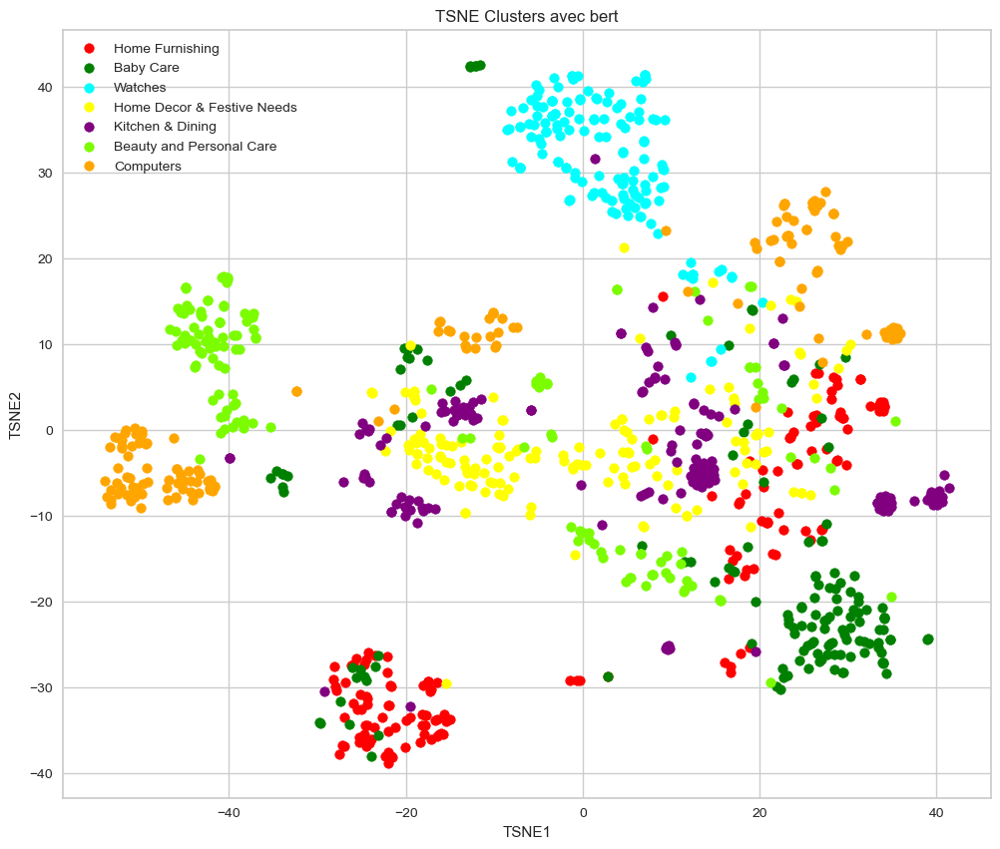

In [134]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append(data['cat_niveau_1'][data['Cluster_cat']==i].unique()[0])
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_bert[data['Cluster_cat']==i,0],
              y = X_tsne_bert[data['Cluster_cat']==i,1], color=color,
              label=target_name)

plt.legend(loc = 'upper left')
# plt.grid()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters avec bert')

In [135]:
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_bert)

array([[15.077411, 72.927895, 46.433533, ..., 58.132324, 43.518387,
        16.267427],
       [12.202589, 64.04411 , 52.6297  , ..., 42.055008, 35.99064 ,
        28.92926 ],
       [12.908636, 63.308372, 52.025642, ..., 41.632065, 35.22697 ,
        28.653954],
       ...,
       [53.944164, 26.960697, 31.200788, ..., 40.85986 ,  8.426188,
        41.02774 ],
       [56.51514 , 25.061325, 31.639164, ..., 41.915565, 10.503746,
        43.197834],
       [55.72928 , 25.1177  , 32.216652, ..., 40.911022,  9.457664,
        42.939995]], dtype=float32)

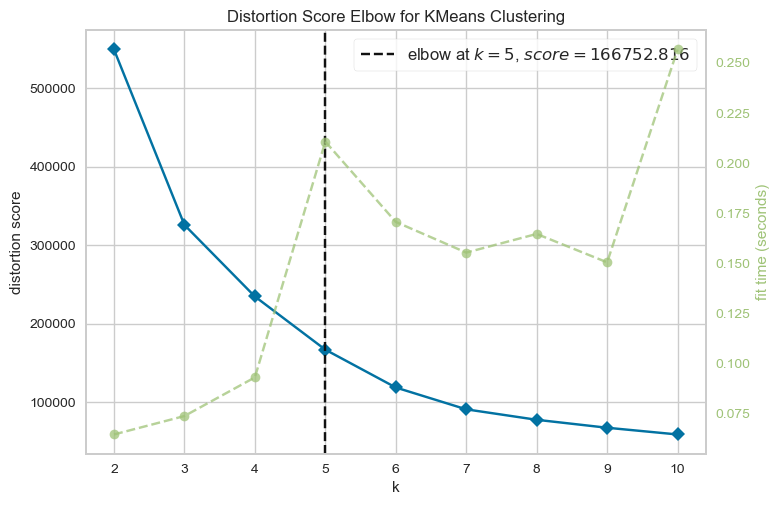

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [136]:
# Instantiate the clustering model and visualizer
visualizer = KElbowVisualizer(KMeans(),K=(4,12))

visualizer.fit(X_tsne_bert)    # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

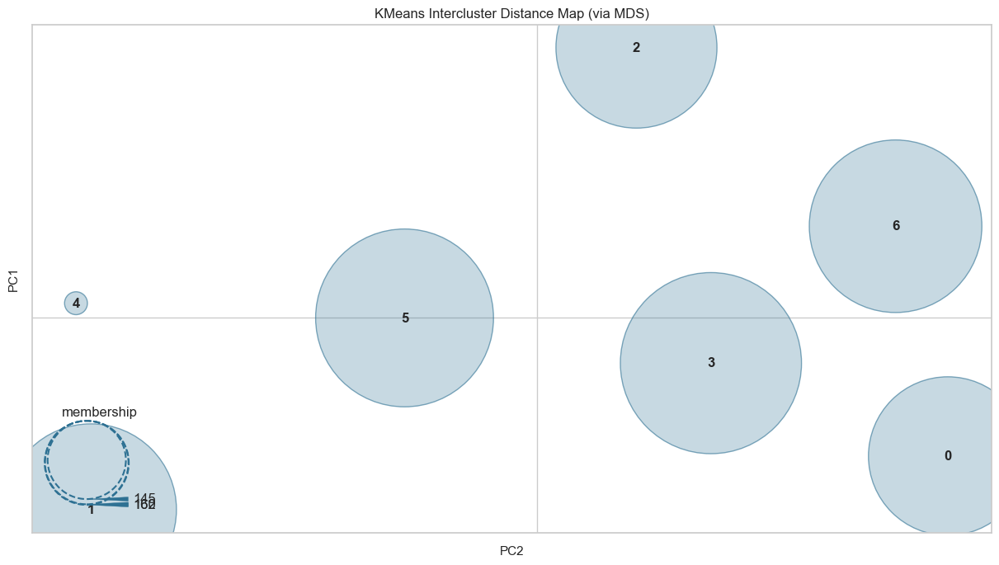

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [137]:
fig = plt.figure(figsize=(15,8))

K = visualizer.elbow_value_
distance_visualizer = InterclusterDistance(kmeans)
distance_visualizer.fit(X_tsne_bert)
distance_visualizer.show()

In [138]:
data['Cluster'] = kmeans.labels_

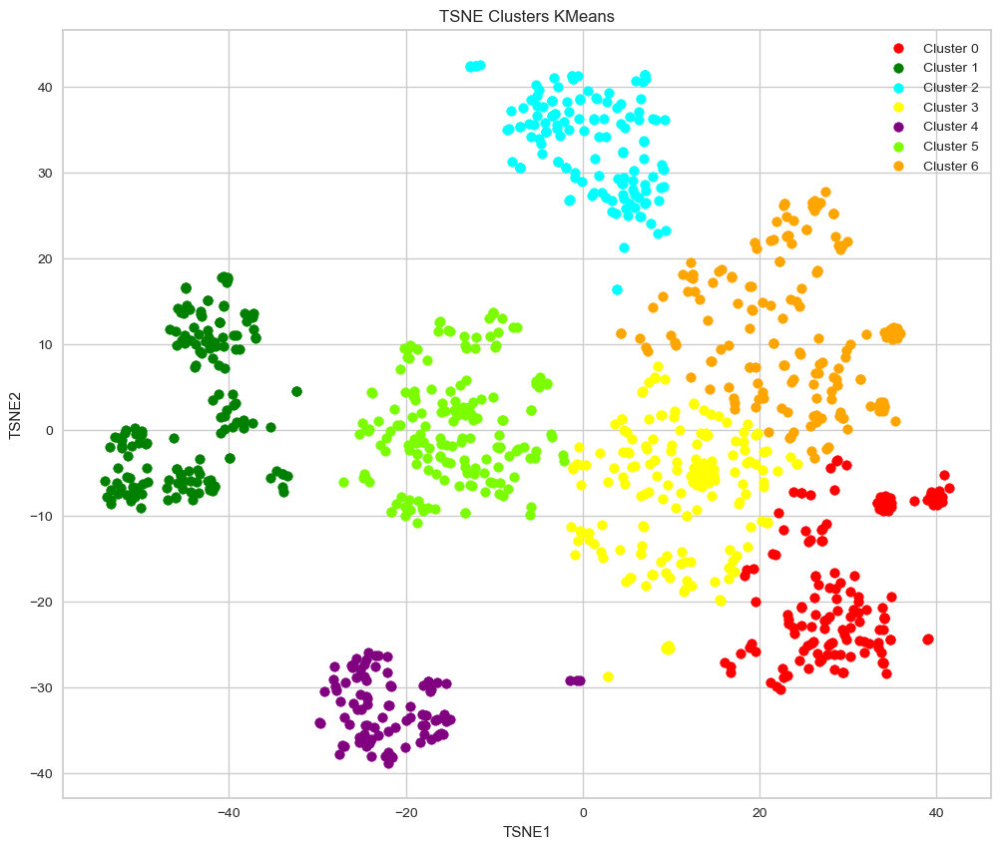

In [139]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_bert[data['Cluster']==i,0], y = X_tsne_bert[data['Cluster']==i,1], color=Colors[i], label=target_name)

plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters KMeans')

plt.show()

In [ ]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_tf = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_bertclasses = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_bert ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))

In [140]:
%time
print('ARI score BERT (LEM) : ',adjusted_rand_score(data['Cluster'], data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score BERT (LEM) :  0.31178707171002695


### 3. USE (Universal Sentence Encoder)

In [141]:
import tensorflow as tf

In [142]:
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder-large/5")

In [143]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [144]:
batch_size = 10
sentences = data['lemmatizer'].to_list()

In [145]:
features_USE = feature_USE_fct(sentences, batch_size)

In [146]:
X = features_USE
X_tsne_USE = TSNE(n_components=2).fit_transform(X)

Text(0.5, 1.0, 'TSNE Clusters USE')

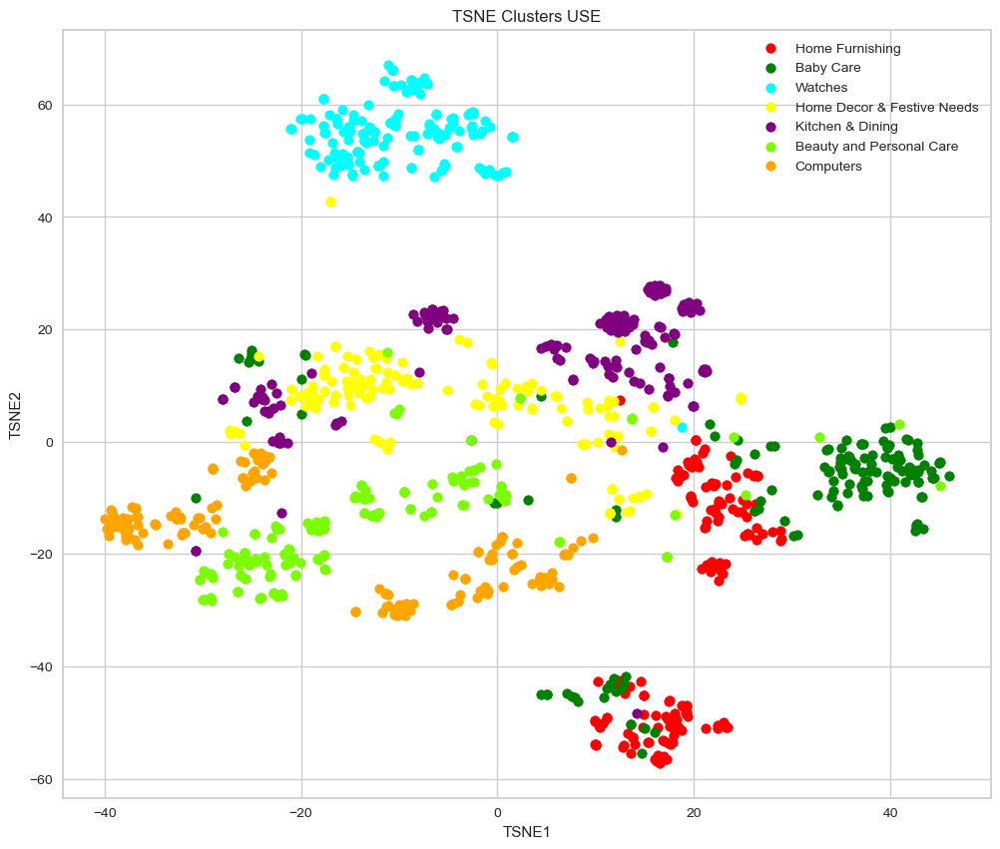

In [147]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append(data['cat_niveau_1'][data['Cluster_cat']==i].unique()[0])
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_USE[data['Cluster_cat']==i,0],
              y = X_tsne_USE[data['Cluster_cat']==i,1], color=color,
              label=target_name)

plt.legend()


plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters USE')

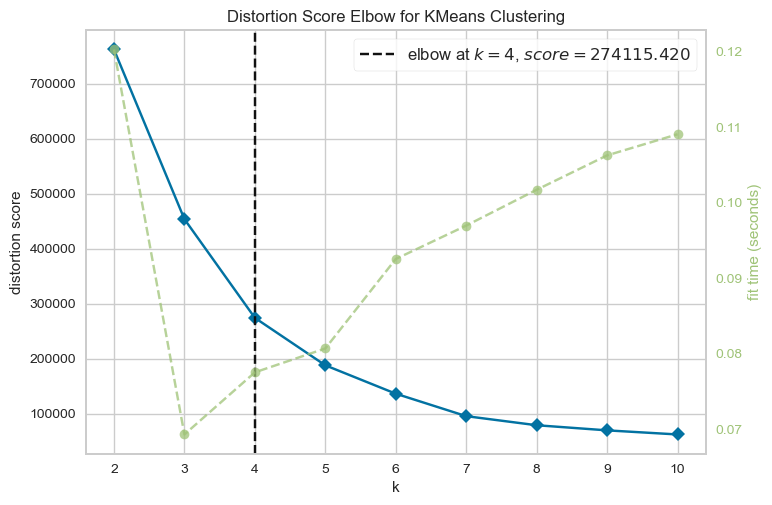

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [148]:
visualizer = KElbowVisualizer(KMeans(),K=(4,12))

visualizer.fit(X_tsne_USE)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [149]:
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=9)
kmeans.fit_transform(X_tsne_USE)

array([[67.51291  , 47.72845  , 11.967873 , ..., 43.612553 , 24.28032  ,
        20.479233 ],
       [67.604706 , 53.702583 ,  8.013163 , ..., 47.19526  , 30.419342 ,
        20.619993 ],
       [68.13507  , 53.401394 ,  7.7175303, ..., 46.48801  , 29.974161 ,
        21.099365 ],
       ...,
       [41.401127 , 33.140263 , 60.781578 , ..., 76.88673  , 40.884148 ,
        37.026043 ],
       [42.944004 , 31.532743 , 60.269558 , ..., 75.58624  , 39.629917 ,
        37.0518   ],
       [42.05425  , 32.445637 , 60.5113   , ..., 76.295784 , 40.309834 ,
        36.981884 ]], dtype=float32)

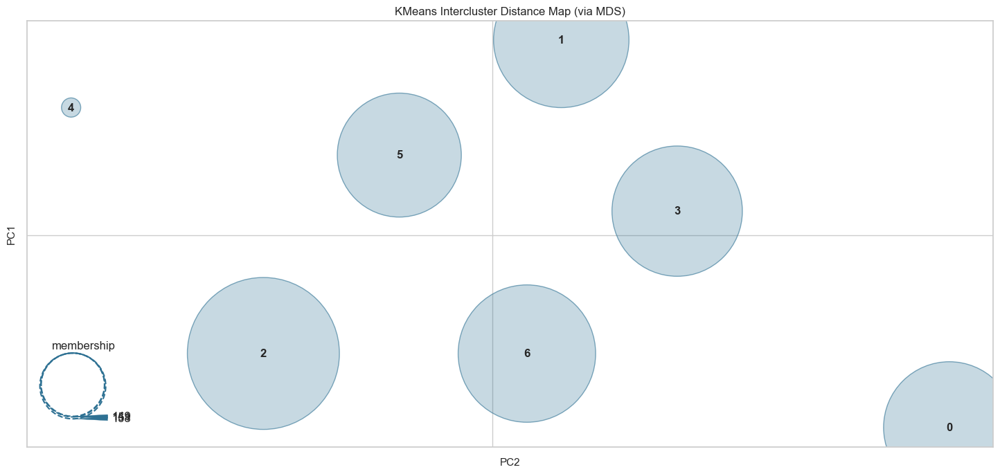

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [150]:
fig = plt.figure(figsize=(18,8))

K = visualizer.elbow_value_
distance_visualizer = InterclusterDistance(kmeans)
distance_visualizer.fit(X_tsne_USE)
distance_visualizer.show()

In [151]:
data['Cluster'] = kmeans.labels_

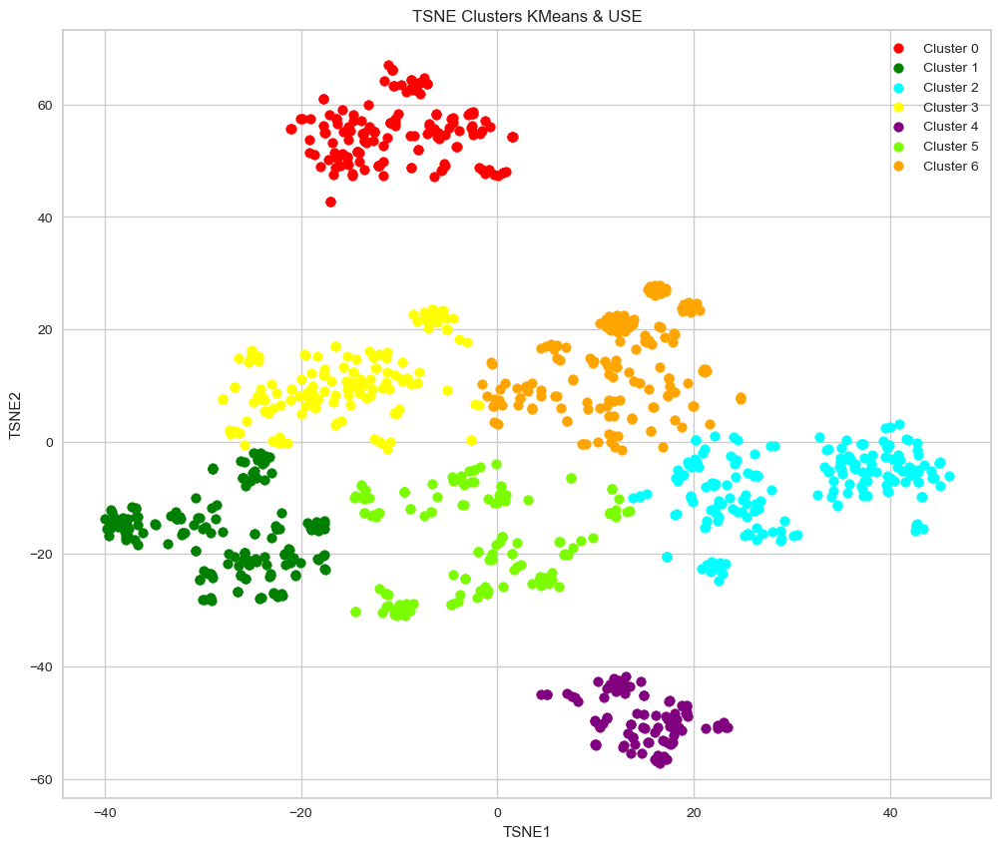

In [152]:
fig = plt.figure(figsize=(12,10))

target_name = []
j=[]
for i in range(data['Cluster_cat'].unique().size):
  target_name.append('Cluster %i'%i)
  j.append(i)

data['Color'] = data['Cluster_cat'].map(lambda p: Colors[p])

for color, i, target_name in zip(Colors, j, target_name):
  plt.scatter(x = X_tsne_USE[data['Cluster']==i,0], y = X_tsne_USE[data['Cluster']==i,1], color=Colors[i], label=target_name)

plt.legend()

plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.title('TSNE Clusters KMeans & USE')

plt.show()

In [ ]:
# Matrice de confusion en forme de heatmat
print('Matrice de confusion en forme de heatmap')
cm_use = confusion_matrix(data['Cluster_cat'], kmeans.labels_) 
noms_des_classes = data.cat_niveau_1.unique()
plt.figure(figsize=(10,7))
ax = sns.heatmap(cm_use ,annot=True,linewidths=1, fmt = 'd', xticklabels=noms_des_classes, yticklabels=noms_des_classes)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
plt.show()

# Rapport de classification
print('Rapport de classification')
print(classification_report(data['Cluster_cat'], kmeans.labels_, target_names=noms_des_classes))

In [153]:
%time
print('ARI score suite à la lémmatisation : ',adjusted_rand_score(data['Cluster'], data['Cluster_cat']))

CPU times: total: 0 ns
Wall time: 0 ns
ARI score suite à la lémmatisation :  0.4630308430641367


In [154]:
from sklearn.naive_bayes import MultinomialNB


In [155]:
mnb = MultinomialNB(alpha=1)

In [156]:
mnb.fit(matrix_cat, data['cat_niveau_1'])

MultinomialNB(alpha=1)

In [157]:
mnb.predict(matrix_cat)

array(['Home Furnishing', 'Baby Care', 'Baby Care', ..., 'Baby Care',
       'Baby Care', 'Baby Care'], dtype='<U26')

In [158]:
from sklearn.metrics import accuracy_score


In [159]:
print('accuracy sur jeu train : ', accuracy_score(mnb.predict(matrix_cat), data['cat_niveau_1']))

accuracy sur jeu train :  0.9647619047619047


In [160]:
print('accuracy sur jeu test : ', 
      accuracy_score(mnb.predict(
          (tfidf.transform(train['description']))), train['cat_niveau_1']))

accuracy sur jeu test :  0.9618805590851334


In [161]:
print('accuracy sur jeu test : ', 
      accuracy_score(mnb.predict(
          (tfidf.transform(test['description']))), test['cat_niveau_1']))

accuracy sur jeu test :  0.9809885931558935


In [162]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

In [163]:
params = {'C' : [0.01, 0.1, 0.5, 0.9, 1, 1.1]}

In [164]:
svc = GridSearchCV(SVC(), param_grid = params, cv=5)

In [165]:
svc.fit(matrix_cat, data['cat_niveau_1'])

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.01, 0.1, 0.5, 0.9, 1, 1.1]})

In [166]:
svc.best_estimator_

SVC(C=1.1)

In [167]:
print('accuracy sur jeu train : ', accuracy_score(svc.best_estimator_.predict(matrix_cat), data['cat_niveau_1']))
print('accuracy sur jeu test : ', 
      accuracy_score(svc.best_estimator_.predict(
          (tfidf.transform(test['lemmatizer']))), test['cat_niveau_1']))

accuracy sur jeu train :  0.9990476190476191
accuracy sur jeu test :  1.0


Nous avons de bons scores accuracy

In [168]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
params2 = {'C' : [0.01, 0.1, 0.5, 0.9, 1, 1.1]}
svc2 = GridSearchCV(SVC(), param_grid = params, cv=5)

In [169]:
from sklearn.decomposition import LatentDirichletAllocation

In [170]:
lda = LatentDirichletAllocation(n_components = data['cat_niveau_1'].nunique(),
                               random_state=2)

In [171]:
lda.fit(matrix_cat)

LatentDirichletAllocation(n_components=7, random_state=2)

In [172]:
svc2.fit(lda.transform(tfidf.transform(train['lemmatizer'])), train['cat_niveau_1'])

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.01, 0.1, 0.5, 0.9, 1, 1.1]})

In [173]:
lda.transform(tfidf.transform(train['lemmatizer'])).shape

(787, 7)

In [174]:
print('accuracy sur jeu train : ', 
      accuracy_score(svc2.best_estimator_.predict(
          lda.transform(tfidf.transform(train['description']))), train['cat_niveau_1']))
print('accuracy sur jeu test : ', 
      accuracy_score(svc2.best_estimator_.predict(
          lda.transform(tfidf.transform(test['description']))), test['cat_niveau_1']))

accuracy sur jeu train :  0.39898348157560354
accuracy sur jeu test :  0.38783269961977185


avec SVC nous n'avons pas une bonne accuracy

In [175]:
del lda

In [176]:
X = pd.concat([train, test])

In [177]:
from sklearn.decomposition import PCA

X = tfidf.transform(X['description']).todense()

In [178]:
from sklearn.preprocessing import StandardScaler

In [179]:
ss_nlp = StandardScaler()

In [180]:
X = np.asarray(X)

In [181]:
X = ss_nlp.fit_transform(X)
pca = PCA()
pca.fit(X)

PCA()

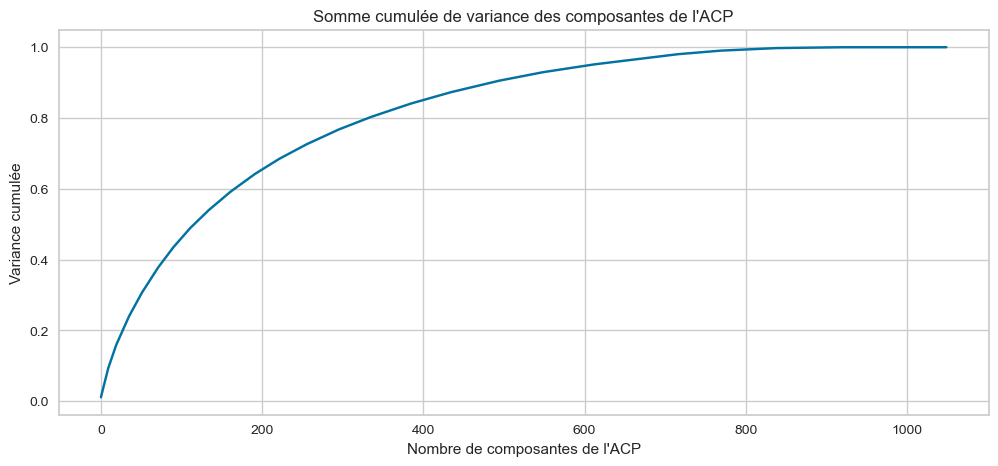

In [182]:
plt.figure(figsize=(12,5))
plt.title('Somme cumulée de variance des composantes de l\'ACP')
plt.xlabel('Nombre de composantes de l\'ACP')
plt.ylabel('Variance cumulée')
plt.plot(list(range(X.shape[0])),
         np.cumsum(pca.explained_variance_ratio_))

In [183]:
sum_pca = np.cumsum(pca.explained_variance_ratio_)
for counter, value in enumerate(sum_pca):
    if value > 0.80:
        X_reduce = pca.transform(X)[:,:counter]
        break
    

In [184]:
print('nombre de features : {}, variance : {}'.format(counter+1,np.cumsum(pca.explained_variance_ratio_)[counter]))

nombre de features : 333, variance : 0.8004175800466126


In [185]:
X_reduce.shape

(1050, 332)

In [186]:
X_reduce.dtype

dtype('float64')

In [187]:
np.save('data_saved_X_reduce_NLP.csv', X_reduce)

In [188]:
X.dtype

dtype('float64')

In [189]:
X.shape[0]

1050

In [190]:
np.save('data_saved_X_reduce_NLP.csv', X_reduce)

In [191]:
from ipywidgets import IntProgress
from ipywidgets import Text
from IPython.display import display
import time
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN

In [192]:
dict_kmeans_nlp = {}

inertia_nlp = {}

max_clusters_nlp=100


f = IntProgress(min=1, max=max_clusters_nlp) # instantiate the bar
chaine = str(1)+'/'+str(max_clusters_nlp)
g = Text(value=chaine)
display(f) # display the bar
display(g)

for k in range(1,max_clusters_nlp):
    Kmeans_model = KMeans(n_clusters=k,
                   verbose=0,
                   random_state=0,
                   )
    kmeans_nlp =Kmeans_model.fit(X_reduce)
    inertia_nlp[k] = kmeans_nlp.inertia_
    dict_kmeans_nlp[k] = kmeans_nlp
    f.value = k # signal to increment the progress bar
    g.value =str(k)+'/'+str(max_clusters_nlp)

IntProgress(value=1, min=1)

Text(value='1/100')

<Axes: title={'center': 'Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters'}>

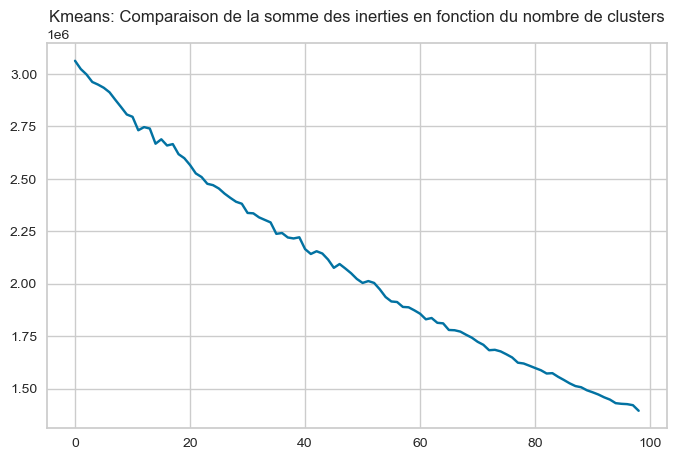

In [193]:
plt.figure(figsize=(8,5))
plt.title('Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters')
sns.lineplot(
             list(inertia_nlp.values())
            )

In [194]:
from sklearn.metrics import silhouette_score

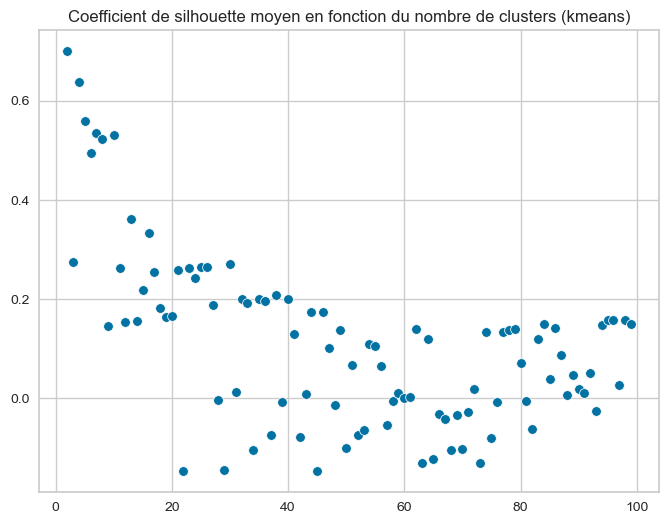

In [195]:
silhouettes_kmeans_nlp = {}
for i in range(2,max_clusters_nlp):
    silhouettes_kmeans_nlp[i] = silhouette_score(X = X_reduce,
                                             labels= list(dict_kmeans_nlp[i].labels_))

plt.figure(figsize=(8,6)),
plt.title('Coefficient de silhouette moyen en fonction du nombre de clusters (kmeans)')
sns.scatterplot(x = list(silhouettes_kmeans_nlp.keys()),
               y = list(silhouettes_kmeans_nlp.values()))
plt.show()

In [196]:
for key, value in silhouettes_kmeans_nlp.items():
    if value == max(silhouettes_kmeans_nlp.values()):
        print('le coefficient de silhouette est maximal pour {} clusters (score = {})'.format(key, value))
        nb_clusters_optimal = key

le coefficient de silhouette est maximal pour 2 clusters (score = 0.6994499636182543)


In [197]:
if nb_clusters_optimal < 5:
    nb_clusters_optimal = 10

In [198]:
dict_kmeans_nlp[nb_clusters_optimal]

KMeans(n_clusters=10, random_state=0)

In [199]:
train_nlp = pd.concat([train, test]).copy()
train_nlp['label_kmeans'] = dict_kmeans_nlp[nb_clusters_optimal].labels_

In [200]:
groups_cat_kmeans_nlp = train_nlp[['cat_niveau_1', 'label_kmeans']].groupby('label_kmeans')
val_presence = []
for i in range(1,nb_clusters_optimal):
    val_presence.append(groups_cat_kmeans_nlp.get_group(i).groupby('cat_niveau_1').count().sort_values(by='label_kmeans', ascending=False).iloc[0].tolist()[0]/groups_cat_kmeans_nlp.get_group(i).groupby('cat_niveau_1').count().sum().values.tolist()[0]*100)

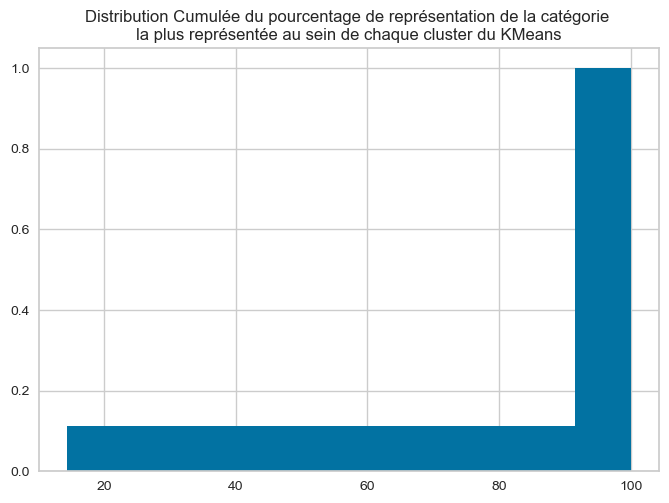

In [201]:
plt.title('Distribution Cumulée du pourcentage de représentation de la catégorie \nla plus représentée au sein de chaque cluster du KMeans')
plt.hist(val_presence,cumulative=True, density=True, bins=nb_clusters_optimal)
plt.show()

# Image

In [202]:
from PIL import Image as Image_PIL

In [203]:
def get_files(path_list):
    '''Renvoie la liste des matrices d\'images à partir d'une liste de chemins'''
    liste_image = []
    compteur = 0
    for image_path in path_list:
        #im = cv2.imread(image_path, 0)
        im = np.array(Image_PIL.open(image_path))
        liste_image.append(im)
        compteur +=1

    del compteur
    del im

    return liste_image

In [204]:
def redim(array_im, width, height):
    '''Redimensionne l\'image correspondant à array_im dans la largeur et la hauteur définie'''
    min_x = 100000
    max_x = 0
    min_y = 100000
    max_y = 0
    shape = array_im.shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]
    im = cv2.resize(array_im, dsize=(width,height))

    del shape

    return im

In [205]:
train['image'] = train['image'].apply(lambda x:'Images/'+str(x))
test['image'] = test['image'].apply(lambda x:'Images/' +str(x))

In [206]:
train_cnn = get_files(train.copy()['image'].tolist())

In [207]:
test_cnn = get_files(test.copy()['image'].tolist())

In [208]:
train_cnn

[array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        ...,
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
  

In [209]:
pip install opencv-python==4.6.0.66

In [210]:
import cv2

In [211]:
train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])

In [212]:
np.save('data_saved_train_images_array', train_array_cnn)
np.save('data_saved_test_images_array', test_array_cnn)

In [213]:
if False:
    train['image'] = train['image'].apply(lambda x:'Images/' +str(x))
    test['image'] = test['image'].apply(lambda x:'Images/' +str(x))

    train_cnn = get_files(train.copy()['image'].tolist())
    test_cnn = get_files(test.copy()['image'].tolist())

    train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
    test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])
    del train_cnn,test_cnn
    #sauvegarde train_array_ccn / test_array_cnn
    np.save('data_saved_train_images_array', train_array_cnn)
    np.save('data_saved_test_images_array', test_array_cnn)
else :
    train_array_cnn = np.load('data_saved_train_images_array.npy')
    test_array_cnn = np.load('data_saved_test_images_array.npy')

In [214]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(handle_unknown='ignore')
array_cats = ohe.fit_transform(np.array(train['cat_niveau_1']).reshape(-1,1))

In [215]:
array_cats.todense().shape

(787, 7)

In [216]:
train_array_cats = ohe.transform(train[['cat_niveau_1']]).todense()
test_array_cats = ohe.transform(test[['cat_niveau_1']]).todense()

In [217]:
train_array_cats.shape

(787, 7)

In [218]:
test_array_cats.shape

(263, 7)

In [219]:
ohe.categories_[0].shape[0]

7

In [220]:
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16
from keras.models import Sequential
from keras.layers import  Dense

In [221]:
vgg = VGG16()
vgg.layers.pop()
vgg.layers.pop()

vgg_transfer = Sequential()
vgg_transfer.add(vgg)
vgg_transfer.trainable = False
vgg_transfer.add(Dense(ohe.categories_[0].shape[0], activation='softmax'))
vgg_transfer.compile(loss='mean_squared_error', optimizer='sgd')

In [222]:
train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])

print('train array shape : ', train_array_cnn.shape)
print('train array cats : ', train_array_cats.shape)

train array shape :  (787, 224, 224, 3)
train array cats :  (787, 7)


In [223]:
vgg_transfer.fit(train_array_cnn, train_array_cats, epochs=3, batch_size=20, verbose=1)

Epoch 1/3
40/40 [==============================] - 209s 5s/step - loss: 0.1225
Epoch 2/3
40/40 [==============================] - 180s 4s/step - loss: 0.1225
Epoch 3/3
40/40 [==============================] - 197s 5s/step - loss: 0.1225


In [224]:
vgg_transfer.save_weights('models/weighs_vgg_transfer.weights')

In [225]:
vgg_transfer.load_weights('models/weighs_vgg_transfer.weights')

In [226]:
train.iloc[74]

Unnamed: 0                                                               239
uniq_id                                     8f41774c16a931d71fcf01f8fee171e0
crawl_timestamp                                          2015-12-01 12:40:44
product_url                http://www.flipkart.com/ruchiworld-marble-pot-...
product_name                        Ruchiworld Marble Pot Showpiece  -  4 cm
pid                                                         SHIECH87SYGU7F8A
retail_price                                                          1950.0
discounted_price                                                      1250.0
image                            Images/8f41774c16a931d71fcf01f8fee171e0.jpg
is_FK_Advantage_product                                                False
description                Ruchiworld Marble Pot Showpiece  -  4 cm (Ston...
product_rating                                           No rating available
overall_rating                                           No rating available

1/1 [==============================] - 1s 1s/step


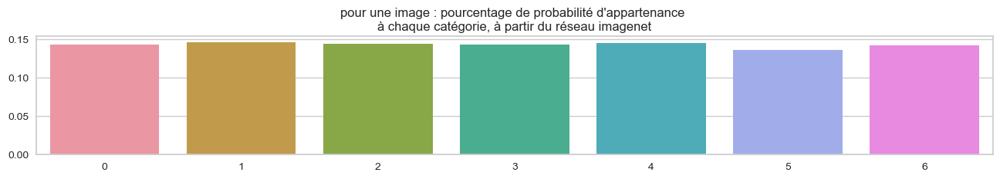

1/1 [==============================] - 0s 374ms/step


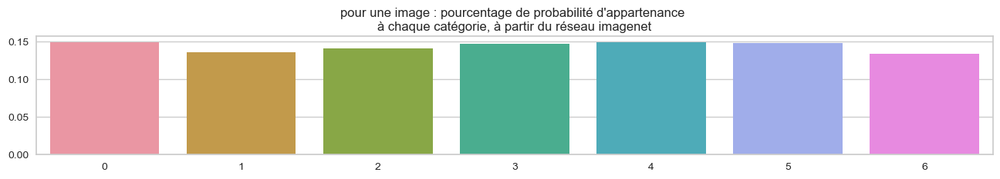

1/1 [==============================] - 0s 445ms/step


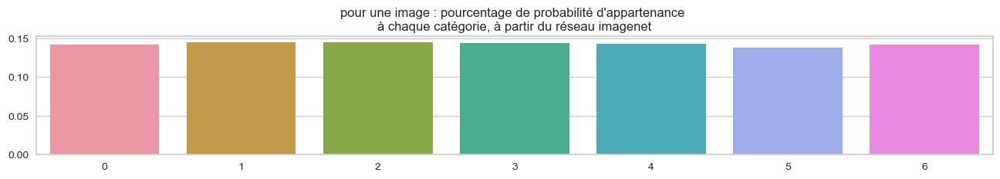

In [227]:
%matplotlib inline
ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[24], 224, 224).reshape(1,224,224,3))
plt.figure(figsize=(16,2))
plt.title('pour une image : pourcentage de probabilité d\'appartenance \nà chaque catégorie, à partir du réseau imagenet')
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])),
            y = ex_prediction_vgg[0])
plt.show()
ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[28], 224, 224).reshape(1,224,224,3))
plt.figure(figsize=(16,2))
plt.title('pour une image : pourcentage de probabilité d\'appartenance \nà chaque catégorie, à partir du réseau imagenet')
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])),
            y = ex_prediction_vgg[0])
plt.show()
ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[74], 224, 224).reshape(1,224,224,3))
plt.figure(figsize=(16,2))
plt.title('pour une image : pourcentage de probabilité d\'appartenance \nà chaque catégorie, à partir du réseau imagenet')
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])),
            y = ex_prediction_vgg[0])
plt.show()

In [228]:
vgg_train_output = vgg_transfer.predict(train_array_cnn)
vgg_test_output = vgg_transfer.predict(test_array_cnn)

9/9 [==============================] - 62s 7s/step


In [229]:
vgg_train_output.shape

(787, 7)

In [230]:
vgg_test_output.shape

(263, 7)

In [231]:
vgg_output = np.vstack([vgg_train_output, vgg_test_output])

In [232]:
vgg_output.shape

(1050, 7)

In [233]:
np.save('data_saved_transfer_learning_output', vgg_output)

In [234]:
X_NLP = np.load('data_saved_X_reduce_NLP.csv.npy')
X_descripteurs = np.load('data_saved_array_features_descripteurs.npy')
X_CNN = np.load('data_saved_transfer_learning_output.npy')

In [235]:
X_NLP.shape

(1050, 332)

In [236]:
np.vstack([np.array(train['discounted_price']).reshape(-1,1),
           np.array(test['discounted_price']).reshape(-1,1)])

array([[  349.],
       [ 5436.],
       [13500.],
       ...,
       [  356.],
       [  550.],
       [  950.]])

In [237]:
data.columns

Index(['Unnamed: 0', 'uniq_id', 'product_url', 'product_name',
       'discounted_price', 'image', 'description', 'cat_niveau_1',
       'Cluster_cat', 'cleaned_description', 'lemmatizer', 'tokenized',
       'stemmer', 'tokenize_stem', 'bigram', 'bigram_trigram', 'Cluster',
       'group', 'word_length', 'Color'],
      dtype='object')

In [238]:
np.array(data['discounted_price']).reshape(-1,1).shape[1]

1

In [239]:
print('NLP : ', X_NLP.shape)
print('Descripteurs : ', X_descripteurs.T.shape)
print('CNN : ', X_CNN.shape)

NLP :  (1050, 332)
Descripteurs :  (1050, 6)
CNN :  (1050, 7)


In [240]:
X_combined = np.hstack([np.array(data['discounted_price']).reshape(-1,1),
           X_NLP,
           X_CNN,
           X_descripteurs.T])

In [241]:
X_combined.shape

(1050, 346)

In [242]:
np.nan_to_num(X_combined, 0)

array([[ 8.99000000e+02, -3.38423118e-01, -1.94393902e-01, ...,
         1.58554614e+03,  1.53046328e+05,  2.10535040e+07],
       [ 4.49000000e+02, -3.87354813e-01, -1.17606704e+00, ...,
         1.41618787e+03,  1.02814805e+05,  1.22624530e+07],
       [ 0.00000000e+00, -5.08975999e-01, -1.55192406e+00, ...,
         1.66602747e+03,  1.70512578e+05,  2.33109740e+07],
       ...,
       [ 1.44900000e+03, -2.21851736e-01, -5.97098893e-01, ...,
         1.26231287e+03,  8.08644219e+04,  9.39830700e+06],
       [ 1.33300000e+03, -5.08959598e-01, -1.54782620e+00, ...,
         1.51630042e+03,  1.25671984e+05,  1.53128000e+07],
       [ 5.95000000e+02, -4.75669967e-01, -1.47406748e+00, ...,
         1.41296643e+03,  1.02172477e+05,  1.18697620e+07]])

In [243]:
np.save('data_saved_X_combined', X_combined)

In [244]:
X_combined = np.load('data_saved_X_combined.npy')

In [245]:
dict_kmeans = {}
inertia = {}
max_clusters=80

f = IntProgress(min=0, max=max_clusters) # instantiate the bar
g = Text(value='')
display(f) # display the bar
display(g)

for k in range(1,max_clusters+1):
    kmeans = KMeans(n_clusters=k,
                   verbose=0,
                   random_state=0,
                   ).fit(X_combined)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    f.value = k # signal to increment the progress bar
    g.value =str(k)+'/'+str(max_clusters)

IntProgress(value=0, max=80)

Text(value='')

<Axes: title={'center': 'Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters'}>

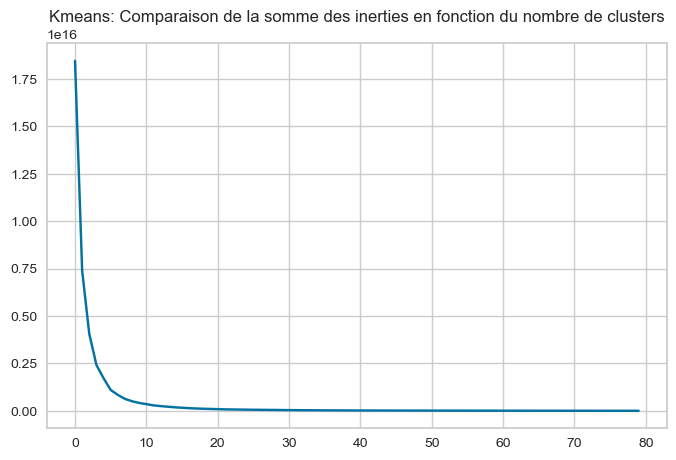

In [247]:
plt.figure(figsize=(8,5))
plt.title('Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters')
sns.lineplot(
             list(inertia.values())
            )

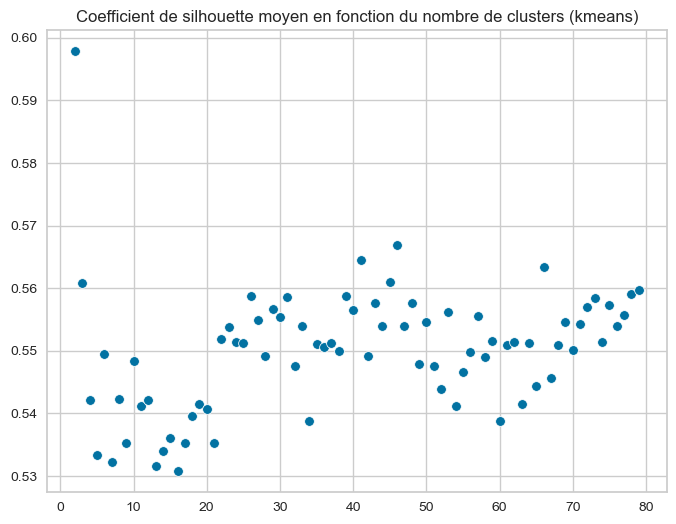

In [248]:
silhouettes_kmeans = {}
for i in range(2,max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = X_combined,
                                             labels= list(dict_kmeans[i].labels_))

plt.figure(figsize=(8,6)),
plt.title('Coefficient de silhouette moyen en fonction du nombre de clusters (kmeans)')
sns.scatterplot(x = list(silhouettes_kmeans.keys()),
               y = list(silhouettes_kmeans.values()))
plt.show()

In [249]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('le coefficient de silhouette est maximal pour {} clusters (score = {})'.format(key, value))
        nb_clusters = key

le coefficient de silhouette est maximal pour 2 clusters (score = 0.5978282329531648)


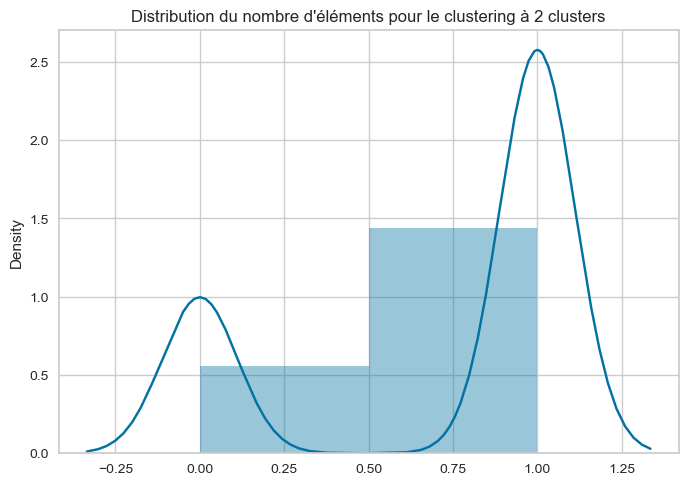

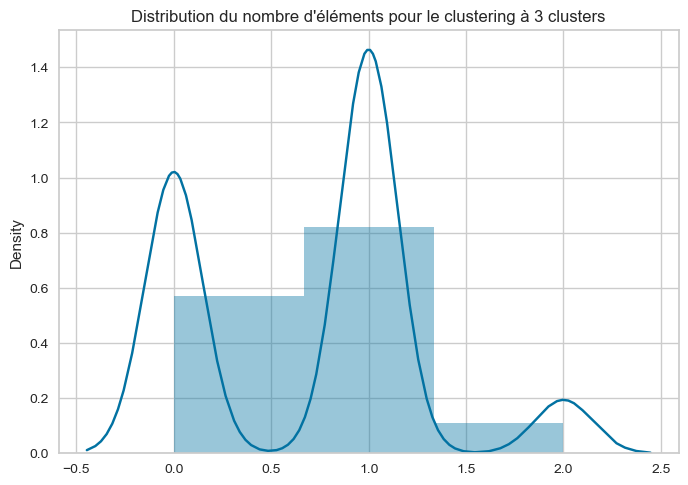

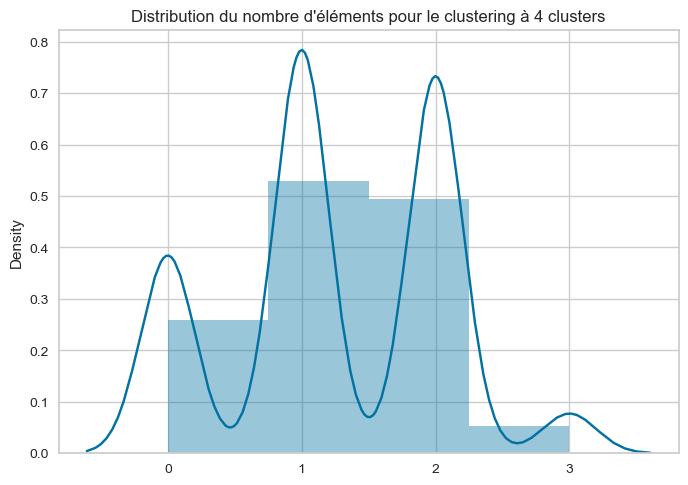

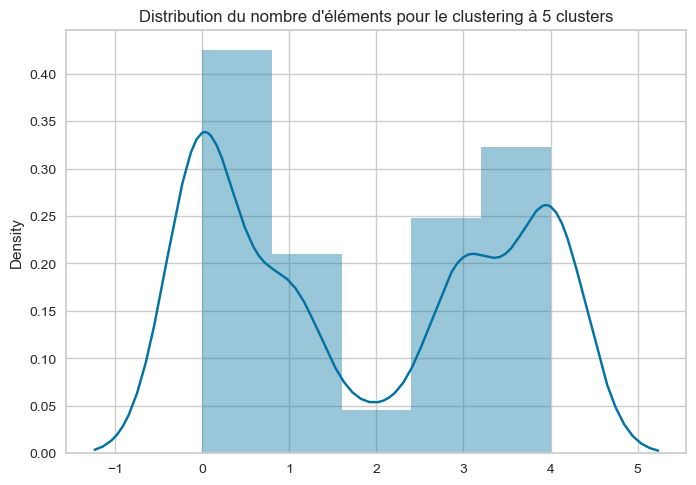

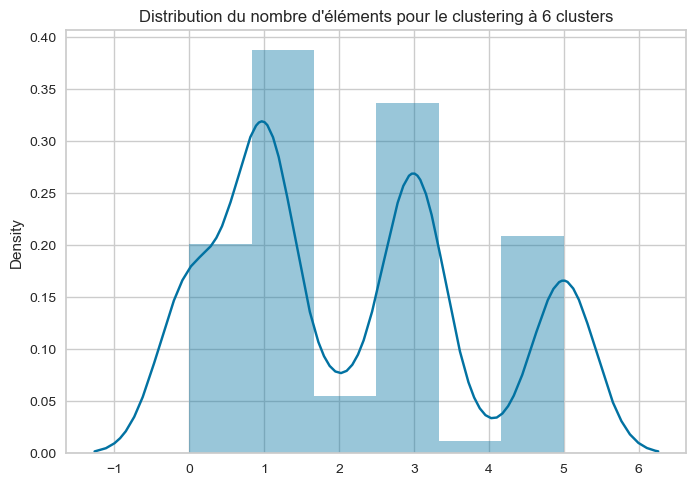

...

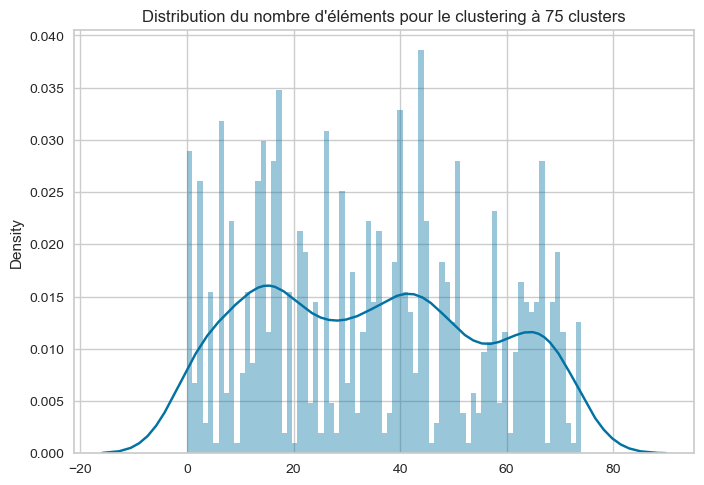

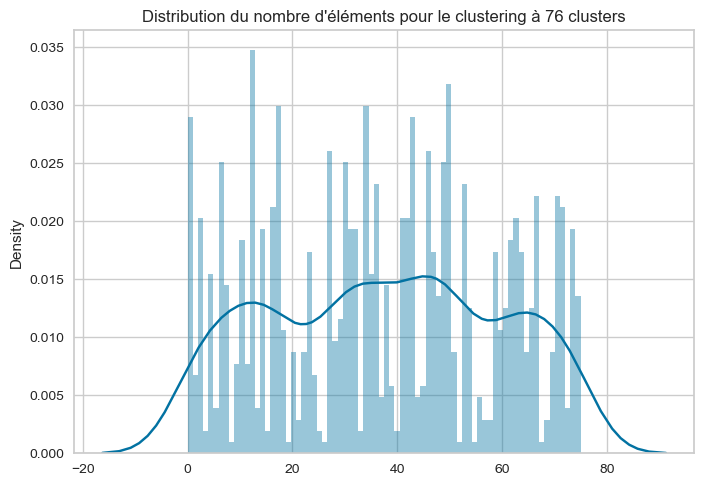

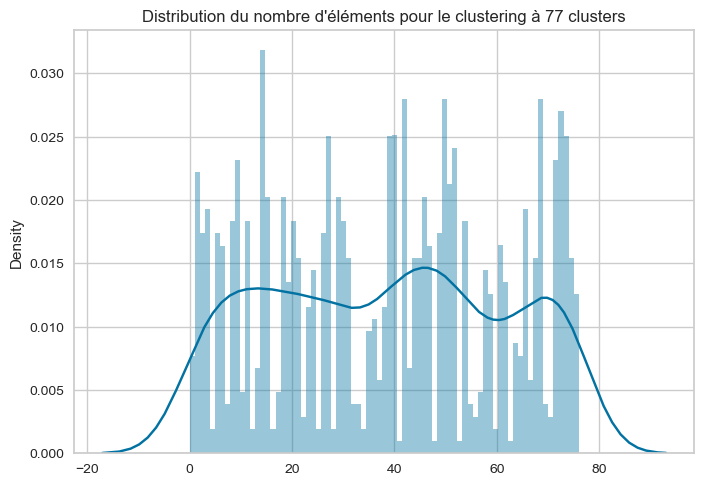

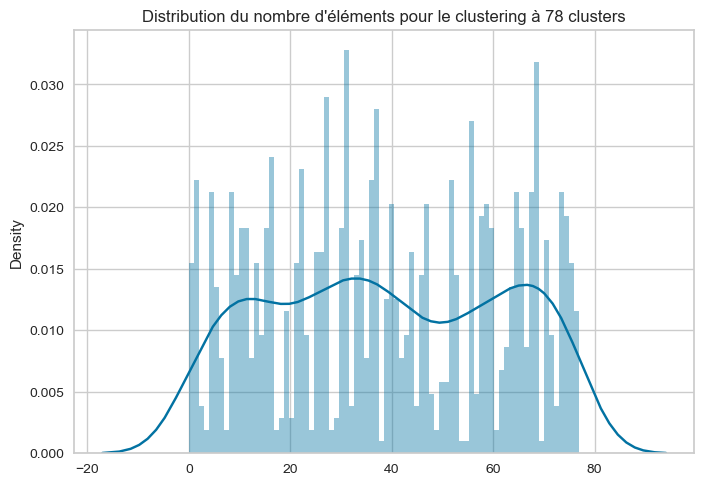

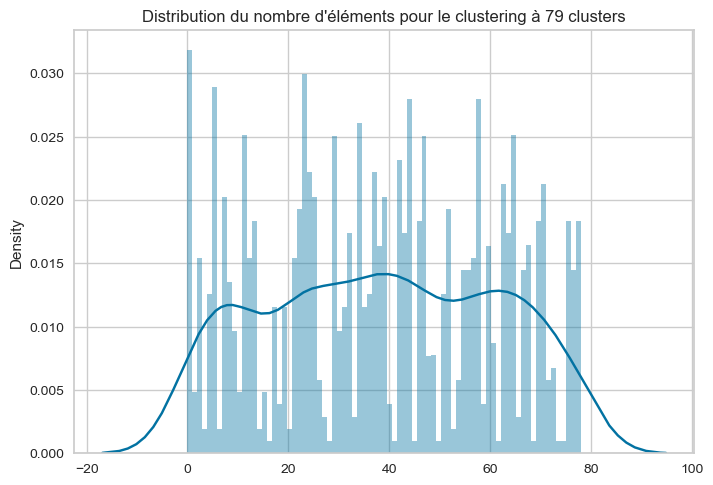

In [250]:
%matplotlib inline
for i in range(2,max_clusters):
    plt.figure()
    titre = 'Distribution du nombre d\'éléments pour le clustering à '+ str(i)+ ' clusters'
    plt.title(titre)
    sns.distplot(dict_kmeans[i].labels_, bins=i)
    plt.show()

In [251]:
jeu_categoriel = pd.DataFrame(X_NLP)
jeu_categoriel['label'] = dict_kmeans[7].labels_

In [252]:
jeu_categoriel.to_csv('data_saved_jeu_complet_kmeans.csv')

In [253]:
jeu_categoriel.shape

(1050, 333)

In [254]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2)
T = tsne.fit_transform(X_combined.copy())

<Axes: title={'center': 'Représentation du jeu de données via T-SNE'}>

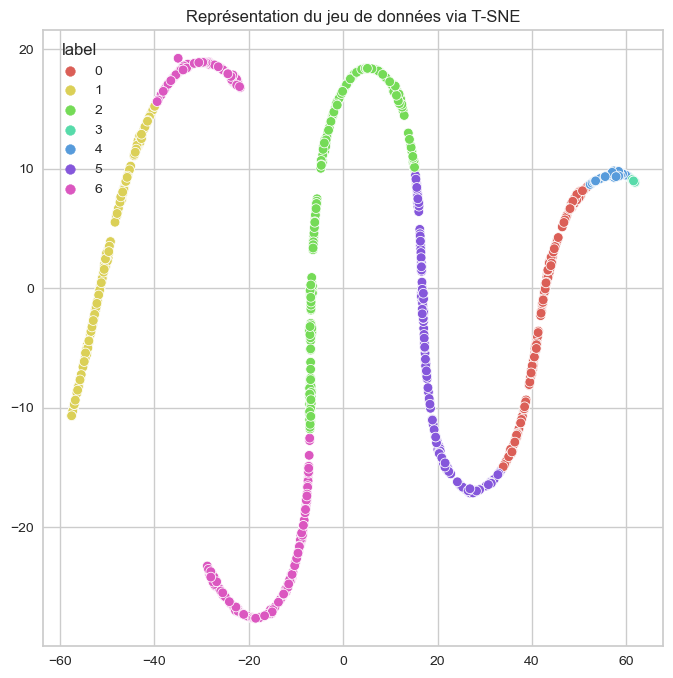

In [255]:
plt.figure(figsize=(8,8))
plt.title('Représentation du jeu de données via T-SNE')
palette_sns = sns.color_palette("hls", jeu_categoriel['label'].nunique())
sns.scatterplot(x= T[:,0],
                y= T[:,1],
                hue= jeu_categoriel['label'],
                palette= palette_sns)

In [256]:
T.shape

(1050, 2)

In [257]:
X_combined.shape

(1050, 346)

In [258]:
data_final = pd.concat([train, test])
data_final['X_TSNE'] = T[:,0]
data_final['Y_TSNE'] = T[:,1]

In [259]:
data_final.set_index('Unnamed: 0', inplace=True)

In [260]:
data_final['label'] = jeu_categoriel['label'].tolist()

In [261]:
data_final.shape

(1050, 26)

In [262]:
data_final.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name', 'pid',
       'retail_price', 'discounted_price', 'image', 'is_FK_Advantage_product',
       'description', 'product_rating', 'overall_rating', 'brand',
       'product_specifications', 'cat_niveau_1', 'cat_niveau_2',
       'cat_niveau_3', 'Cluster_cat', 'cleaned_description', 'lemmatizer',
       'tokenized', 'stemmer', 'tokenize_stem', 'X_TSNE', 'Y_TSNE', 'label'],
      dtype='object')

In [263]:
data_final.to_csv('data_saved_data_final.csv', index=False)

In [264]:
data_final.head()

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,...,cat_niveau_3,Cluster_cat,cleaned_description,lemmatizer,tokenized,stemmer,tokenize_stem,X_TSNE,Y_TSNE,label
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,Images/785b4383b12106dd172306d427d8f7b2.jpg,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,...,Rockmantra Coffee Mugs,4,rockmantra cute two cats ceramic mug 55 l\r\n ...,rockmantra cute two cat ceramic mug price give...,"['rockmantra', 'cute', 'two', 'cat', 'ceramic'...",rockmantra cute two cat ceram mug price give t...,"['rockmantra', 'cute', 'two', 'cat', 'ceram', ...",53.115089,8.903414,4
248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,Images/45d0af2c709de47268c80c35a117de44.jpg,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,...,Malhar Showpieces,3,buy malhar niko male doll showpiece 25 cm f...,buy malhar niko male doll showpiece online mal...,"['buy', 'malhar', 'niko', 'male', 'doll', 'sho...",buy malhar niko male doll showpiec onlin malha...,"['buy', 'malhar', 'niko', 'male', 'doll', 'sho...",-7.014514,-0.223059,2
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,Images/64b463dc0b75ae40a848498c657041e6.jpg,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,...,Routers,6,buy linksys smart wifi router only for rs 00 f...,buy linksys smart wifi router flipkartcom genu...,"['buy', 'linksys', 'smart', 'wifi', 'router', ...",buy linksi smart router flipkart com genuin pr...,"['buy', 'linksi', 'smart', 'router', 'flipkart...",57.077808,9.336319,4
685,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,Images/6b5cdfe68595fbcab0e05dc625d3d66a.jpg,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,...,Face Care,5,flipkartcom buy richfeel sunshield spf 30 pa ...,flipkartcom buy richfeel sunshield spf flipkar...,"['flipkartcom', 'buy', 'richfeel', 'sunshield'...",flipkart com buy richfeel sunshield spf flipka...,"['flipkart', 'com', 'buy', 'richfeel', 'sunshi...",20.776585,-14.069193,5
843,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,Images/e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,...,USB Gadgets,6,buy epresent mfan 1 fan usb usb fan for rs219 ...,buy epresent mfan fan usb usb fan online epres...,"['buy', 'epresent', 'mfan', 'fan', 'usb', 'usb...",buy epres mfan fan usb usb fan onlin epres mfa...,"['buy', 'epres', 'mfan', 'fan', 'usb', 'usb', ...",50.338413,7.753379,0


In [265]:
import glob
glob.glob('data_saved/*')

[]

In [266]:
data = pd.read_csv('data_saved_data_final.csv')

In [267]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,...,cat_niveau_3,Cluster_cat,cleaned_description,lemmatizer,tokenized,stemmer,tokenize_stem,X_TSNE,Y_TSNE,label
0,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,Images/785b4383b12106dd172306d427d8f7b2.jpg,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,...,Rockmantra Coffee Mugs,4,rockmantra cute two cats ceramic mug 55 l\r\n ...,rockmantra cute two cat ceramic mug price give...,"['rockmantra', 'cute', 'two', 'cat', 'ceramic'...",rockmantra cute two cat ceram mug price give t...,"['rockmantra', 'cute', 'two', 'cat', 'ceram', ...",53.115090,8.903414,4
1,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,Images/45d0af2c709de47268c80c35a117de44.jpg,True,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,...,Malhar Showpieces,3,buy malhar niko male doll showpiece 25 cm f...,buy malhar niko male doll showpiece online mal...,"['buy', 'malhar', 'niko', 'male', 'doll', 'sho...",buy malhar niko male doll showpiec onlin malha...,"['buy', 'malhar', 'niko', 'male', 'doll', 'sho...",-7.014514,-0.223059,2
2,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,Images/64b463dc0b75ae40a848498c657041e6.jpg,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,...,Routers,6,buy linksys smart wifi router only for rs 00 f...,buy linksys smart wifi router flipkartcom genu...,"['buy', 'linksys', 'smart', 'wifi', 'router', ...",buy linksi smart router flipkart com genuin pr...,"['buy', 'linksi', 'smart', 'router', 'flipkart...",57.077810,9.336319,4
3,6b5cdfe68595fbcab0e05dc625d3d66a,2015-12-31 09:19:31,http://www.flipkart.com/richfeel-sunshield-spf...,Richfeel Sunshield - SPF 30 PA++,SNRE4F2GBWVF6UKR,299.0,224.0,Images/6b5cdfe68595fbcab0e05dc625d3d66a.jpg,False,Flipkart.com: Buy Richfeel Sunshield - SPF 30 ...,...,Face Care,5,flipkartcom buy richfeel sunshield spf 30 pa ...,flipkartcom buy richfeel sunshield spf flipkar...,"['flipkartcom', 'buy', 'richfeel', 'sunshield'...",flipkart com buy richfeel sunshield spf flipka...,"['flipkart', 'com', 'buy', 'richfeel', 'sunshi...",20.776585,-14.069193,5
4,e86daf9ebcdfc5c5dd088cdb7f8f8db6,2015-12-29 05:07:38,http://www.flipkart.com/epresent-mfan-1-fan-us...,Epresent Mfan 1 Fan USB USB Fan,USGEB3HTYWCYT2HY,269.0,219.0,Images/e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg,False,Buy Epresent Mfan 1 Fan USB USB Fan for Rs.219...,...,USB Gadgets,6,buy epresent mfan 1 fan usb usb fan for rs219 ...,buy epresent mfan fan usb usb fan online epres...,"['buy', 'epresent', 'mfan', 'fan', 'usb', 'usb...",buy epres mfan fan usb usb fan onlin epres mfa...,"['buy', 'epres', 'mfan', 'fan', 'usb', 'usb', ...",50.338413,7.753379,0


In [268]:
def resize(img_filename, height):
    original_path = img_path
    final_path = path+'Resized_Images/'
    if 'Images/' in img_filename:
        img_filename = img_filename.split("Images/")[1]

    #chargement image
    img = cv2.imread(original_path + str(img_filename), cv2.IMREAD_UNCHANGED)

    #proportions de l'image
    ratio = img.shape[0]/img.shape[1]
    width = int(height / ratio)

    #recadrer image
    resized = cv2.resize(img, (width, height), interpolation = cv2.INTER_AREA)

    #save image
    cv2.imwrite(str(final_path) + str(img_filename), resized)
    del width, img, ratio
    return True

In [271]:
if False:
    from ipywidgets import IntProgress

    f = IntProgress(min=0, max=len(data['image'].tolist())) # instantiate the bar
    display(f) # display the bar
    k=0
    for image in data['image'].tolist():
        resize(image, height=150)
        k+=1
        f.value = k # signal to increment the progress bar

In [272]:
data.head(1)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,...,cat_niveau_3,Cluster_cat,cleaned_description,lemmatizer,tokenized,stemmer,tokenize_stem,X_TSNE,Y_TSNE,label
0,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,Images/785b4383b12106dd172306d427d8f7b2.jpg,False,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,...,Rockmantra Coffee Mugs,4,rockmantra cute two cats ceramic mug 55 l\r\n ...,rockmantra cute two cat ceramic mug price give...,"['rockmantra', 'cute', 'two', 'cat', 'ceramic'...",rockmantra cute two cat ceram mug price give t...,"['rockmantra', 'cute', 'two', 'cat', 'ceram', ...",53.11509,8.903414,4


In [275]:
data['retail_price'].describe()

count      1049.000000
mean       2186.197331
std        7639.229411
min          35.000000
25%         555.000000
50%         999.000000
75%        1999.000000
max      201000.000000
Name: retail_price, dtype: float64

In [276]:
data['price_as_size'] = pd.qcut(data['retail_price'], 8, labels = [0,1,2,3,4,5,6,7])

In [278]:
data['image'] = data['image'].apply([lambda x : str(x).split('/Images/')[0]])

In [279]:
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models.tools import HoverTool
from bokeh.models import CategoricalColorMapper
from bokeh.transform import factor_cmap, factor_mark
from bokeh.palettes import Category20 as palette
from bokeh.transform import linear_cmap
from bokeh.models import  ColumnDataSource,Range1d, LabelSet, Label

In [280]:
data['label_string'] = data['label'].apply(lambda x : 'cat_'+ str(x))
liste_categories = tuple([str(x) for x in data['label_string'].unique().tolist()])
palette_sns = sns.color_palette("hls", len(liste_categories))

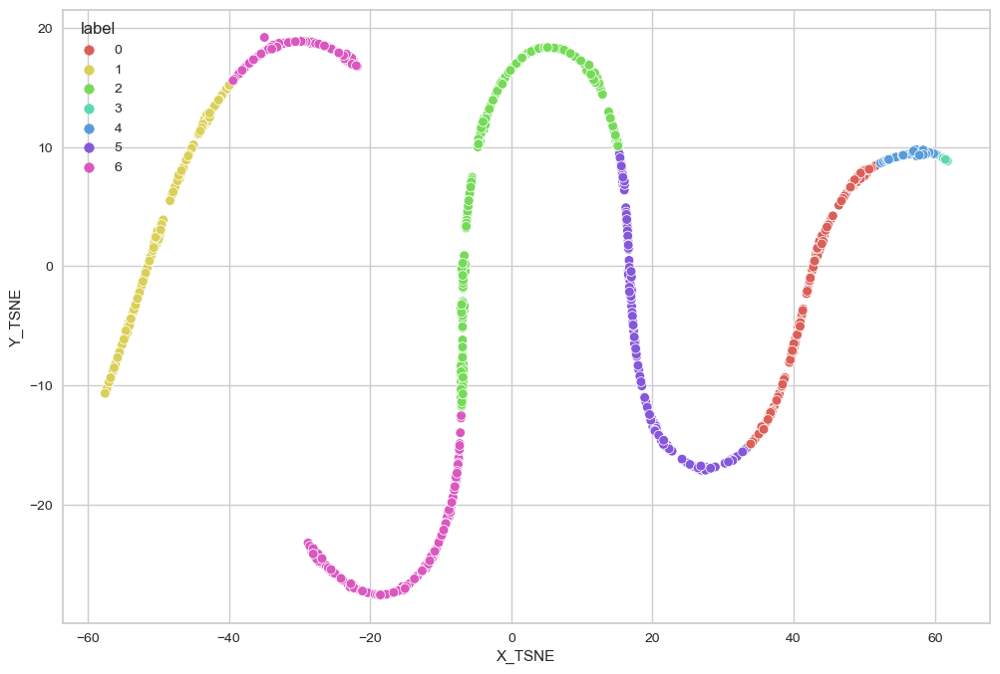

In [281]:
plt.figure(figsize=(12,8))
plt.title('')
sns.scatterplot(x = data['X_TSNE'],
               y= data['Y_TSNE'],
               hue = data['label'],
                palette = palette_sns,
                legend='full')
plt.show()

In [282]:
palette[len(liste_categories)]

('#1f77b4', '#aec7e8', '#ff7f0e', '#ffbb78', '#2ca02c', '#98df8a', '#d62728')

In [283]:
%matplotlib inline
from bokeh.plotting import ColumnDataSource, figure, output_file, show
#create ColumnDataSource from dataframe
source = ColumnDataSource(data)
# allows visualisation in notebook

from bokeh.io import output_notebook

from bokeh.resources import INLINE

output_notebook(INLINE)




# add plot
p = figure(
    title='Représentation de la catégorisation du jeu de données après traitement',
    #tools='',
    x_axis_label = 'TSNE X axis',
    y_axis_label = 'TSNE Y axis',
  
)


colors = {}
for label, color in zip(data['label_string'].unique().tolist(), palette[len(liste_categories)]):
    colors[label] = color

color_map = CategoricalColorMapper(factors = list(colors.keys()),palette=palette[len(liste_categories)])

# render glyph
p.scatter(x='X_TSNE',
          y='Y_TSNE',
          legend_label='label_string',
          line_color = None,
          #fill_color= colors,
          #fill_color = colors,
          color = {'field': 'label_string', 'transform': color_map},
          source=source,
          size='price_as_size',
          line_width = 2,
)


# add text
if False:
    labels = LabelSet(x='X_TSNE', y='Y_TSNE', text='label', level='glyph',text_font_size='7pt',
                      x_offset=5, y_offset=5, source=source, render_mode='canvas')
    p.add_layout(labels)

#add tooltips
hover = HoverTool()
hover.tooltips = """
    <div>
        <div><b>@product_name</b></div>
        <div><b>@cat_lvl_2</b></div>
        </div>Kmeans Category : @label_string</div>
        <div><img src="data/Resized_Images/@image", alt='categorie' /></div>
    </div>"""
p.add_tools(hover)
show(p)

Loading BokehJS ...

In [284]:
%matplotlib inline
show(p)